**1. Preparação**

Importação do dataset

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import pandas as pd
caminho = "/content/drive/Shareddrives/Projetos 5 - G3/Projetos 5 - G3/SR2/Entregáveis - CC/Dataset/censo_arboreo_original.csv"

df = pd.read_csv(caminho, encoding='utf-8')

/tmp/ipython-input-3770813216.py:4: DtypeWarning: Columns (2,7,8,10,11,12,13,14,15,25,27,28,33,34,35,36,37,38,41,42,48,49) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(caminho, encoding='utf-8')


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 259575 entries, 0 to 259574
Data columns (total 56 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   objectid    259575 non-null  int64  
 1   tipo_ponto  259575 non-null  object 
 2   porte_esp   14400 non-null   object 
 3   bairro      259492 non-null  object 
 4   rpa         259575 non-null  int64  
 5   x           259575 non-null  float64
 6   y           259575 non-null  float64
 7   nome_popul  1364 non-null    object 
 8   categoria_  2127 non-null    object 
 9   obs         211919 non-null  object 
 10  created_us  636 non-null     object 
 11  created_da  2480 non-null    object 
 12  last_edite  169 non-null     object 
 13  last_edi_1  169 non-null     object 
 14  tipologia   463 non-null     object 
 15  idlote      18 non-null      object 
 16  origem      258812 non-null  object 
 17  apermeavel  0 non-null       float64
 18  caracsolo   0 non-null       float64
 19  fi

A partir do dataset disponibilizado pela Prefeitura no Portal Dados Abertos, será realizada uma etapa de limpeza e normalização dos dados, essencial para garantir a qualidade e consistência das análises subsequentes. O conjunto de dados possui formato tabular, com colunas delimitadas por vírgula, em que cada linha representa uma árvore registrada no censo e identificada de forma única pela coluna globalid, mantida como chave principal do dataset.

**2. Análise de integridade**

Registros nulos

In [4]:
# Percentual de valores nulos em todas as colunas
percent_nulos = (df.isna().mean() * 100).sort_values(ascending=False).round(2)

# Mostrar todas as colunas com seus percentuais
pd.DataFrame(percent_nulos, columns=["% de nulos"])

,% de nulos
apermeavel,100.00
caracsolo,100.00
contato,100.00
rusticidad,100.00
corflor,100.00
responsave,100.00
invalidaca,100.00
datamonito,100.00
idlote,99.99
execucao,99.99


In [5]:
# Lista final de colunas que devem ser mantidas
colunas_mantidas = [
    'responsave',
    'datamonito',     # data de monitoramento
    'nomecienti',     # nome científico
    'projeto',        # programa/campanha de arborização
    'tipologia',      # tipo de ponto de plantio
    'dataplanti',     # data de plantio
    'nome_popul',     # nome popular
    'injuria',        # ocorrência de injúrias
    'fitossanid',     # estado fitossanitário
    'porte_esp',      # porte da espécie
    'objectid',
    'bairro',
    'rpa',
    'x',
    'y',
    'categoria_',
    'obs',
    'x_wgs84',
    'y_wgs84',
    'altura',
    'dap',
    'copa',
    'cap',
    'nome_comum',
    'longitude',
    'latitude',
    'id',
    'globalid'
]

# Filtra o DataFrame para manter apenas as colunas da lista (ignorando as que não existirem)
df = df.loc[:, df.columns.intersection(colunas_mantidas)]

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 259575 entries, 0 to 259574
Data columns (total 28 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   objectid    259575 non-null  int64  
 1   porte_esp   14400 non-null   object 
 2   bairro      259492 non-null  object 
 3   rpa         259575 non-null  int64  
 4   x           259575 non-null  float64
 5   y           259575 non-null  float64
 6   nome_popul  1364 non-null    object 
 7   categoria_  2127 non-null    object 
 8   obs         211919 non-null  object 
 9   tipologia   463 non-null     object 
 10  nomecienti  108 non-null     object 
 11  copa        259575 non-null  float64
 12  altura      259575 non-null  float64
 13  cap         259575 non-null  float64
 14  dap         259575 non-null  float64
 15  dataplanti  1215 non-null    object 
 16  datamonito  6 non-null       object 
 17  injuria     1675 non-null    object 
 18  fitossanid  2361 non-null    object 
 19  x_

In [7]:
# Percentual de valores nulos em todas as colunas
percent_nulos = (df.isna().mean() * 100).sort_values(ascending=False).round(2)

# Mostrar todas as colunas com seus percentuais
pd.DataFrame(percent_nulos, columns=["% de nulos"])

,% de nulos
responsave,100.00
datamonito,100.00
nomecienti,99.96
projeto,99.87
tipologia,99.82
dataplanti,99.53
nome_popul,99.47
injuria,99.35
categoria_,99.18
fitossanid,99.09


In [8]:
df.head(20)

,objectid,porte_esp,bairro,rpa,x,y,nome_popul,categoria_,obs,tipologia,...,fitossanid,x_wgs84,y_wgs84,nome_comum,globalid,projeto,responsave,id,longitude,latitude
0,36242,NaN,GUA,3,285246.2405,9.122865e+06,NaN,NaN,privado,NaN,...,NaN,-34.948087,-7.930653,0,{5F4D0620-3942-4123-9C1B-F065A54A619B},NaN,NaN,36242,285246.2405,9.122865e+06
1,980,GP,MAC,3,287182.0393,9.113415e+06,NaN,NaN,Tabebuia rosealba,UC,...,NaN,-34.930934,-8.016163,0,{6729306C-25DF-49DA-9725-1A61F5AEF8C0},NaN,NaN,980,287181.3266,9.113424e+06
2,476481,GP,NaN,0,0.0000,0.000000e+00,NaN,NaN,NaN,NaN,...,NaN,0.000000,0.000000,0,{1FA35430-AFD5-45F7-859F-E68059E3DFEB},NaN,NaN,0,293468.4597,9.108291e+06
3,1334,MP,SAM,1,292328.1030,9.110510e+06,Ipê-rosa,NaN,NaN,CC,...,NaN,-34.884382,-8.042639,28,{768A671B-7A04-4F36-9C58-E2A8D169730A},NaN,NaN,1334,292326.9999,9.110514e+06
4,1731,MP,IPU,4,286350.7576,9.110011e+06,NaN,NaN,NaN,QU,...,saudavel,-34.938620,-8.046906,32,{CA09AC2D-F7B1-4BCD-A49F-F85BE8C25D03},NaN,NaN,1731,286350.7576,9.110011e+06
5,1941,GP,SAM,1,292345.7646,9.110492e+06,Ipê-roxo,NaN,NaN,CC,...,NaN,-34.884222,-8.042803,51,{E2B19BB1-882A-4244-B097-30244A7C16B4},NaN,NaN,1941,292346.7058,9.110487e+06
6,2114,MP,SAM,1,292391.4366,9.110503e+06,NaN,NaN,NaN,CL,...,NaN,-34.883807,-8.042705,28,{656391DB-2B2E-472E-86FB-B60252C35BCF},NaN,NaN,2114,292385.4321,9.110509e+06
7,2519,PP,SAM,1,292345.5655,9.110520e+06,Ipê-rosa,NaN,NaN,CC,...,NaN,-34.884223,-8.042551,87,{B5BF95E3-DAC6-4878-A21F-9147DD666A44},NaN,NaN,2519,292344.6239,9.110522e+06
8,36243,NaN,GUA,3,279201.1326,9.122862e+06,NaN,NaN,privado,NaN,...,NaN,-35.002901,-7.930414,0,{601AEF21-9687-42AB-B02C-4F267C149DCA},NaN,NaN,36243,279201.1326,9.122862e+06
9,36244,NaN,GUA,3,279165.0260,9.122860e+06,NaN,NaN,privado,NaN,...,NaN,-35.003228,-7.930437,0,{93A25D17-5CFB-43BF-8F78-9E12330D807B},NaN,NaN,36244,279165.0260,9.122860e+06


In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 259575 entries, 0 to 259574
Data columns (total 28 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   objectid    259575 non-null  int64  
 1   porte_esp   14400 non-null   object 
 2   bairro      259492 non-null  object 
 3   rpa         259575 non-null  int64  
 4   x           259575 non-null  float64
 5   y           259575 non-null  float64
 6   nome_popul  1364 non-null    object 
 7   categoria_  2127 non-null    object 
 8   obs         211919 non-null  object 
 9   tipologia   463 non-null     object 
 10  nomecienti  108 non-null     object 
 11  copa        259575 non-null  float64
 12  altura      259575 non-null  float64
 13  cap         259575 non-null  float64
 14  dap         259575 non-null  float64
 15  dataplanti  1215 non-null    object 
 16  datamonito  6 non-null       object 
 17  injuria     1675 non-null    object 
 18  fitossanid  2361 non-null    object 
 19  x_

Registros duplicados - verificação a partir da coluna globalid

In [10]:
# Verifica se há registros duplicados na coluna 'globalid'
duplicados = df[df.duplicated(subset='globalid', keep=False)]

# Mostra os registros duplicados (se existirem)
print(f"Total de registros duplicados em 'globalid': {duplicados.shape[0]}")
duplicados.head()

Total de registros duplicados em 'globalid': 0


,objectid,porte_esp,bairro,rpa,x,y,nome_popul,categoria_,obs,tipologia,...,fitossanid,x_wgs84,y_wgs84,nome_comum,globalid,projeto,responsave,id,longitude,latitude


Corrigindo dados com RPA = 0

In [11]:
# Listar siglas únicas na RPA 0
siglas_rpa0 = (
    df[df['rpa'] == 0]['bairro']
      .dropna()
      .unique()
)
siglas_rpa0 = sorted(siglas_rpa0)
print(f"Siglas na RPA 0 ({len(siglas_rpa0)}):\n{siglas_rpa0}")

Siglas na RPA 0 (52):
['AFG', 'AGF', 'APP', 'ARE', 'ARR', 'BBH', 'BVG', 'BVS', 'CAJ', 'CAX', 'CBG', 'CCT', 'CDB', 'CHB', 'CMG', 'COE', 'CRD', 'CSA', 'CSF', 'DBY', 'DIR', 'ENC', 'ENG', 'EST', 'GRA', 'HIP', 'IBU', 'IMB', 'IPS', 'IPU', 'IRE', 'JAQ', 'JIQ', 'JSP', 'LTR', 'MAC', 'MAD', 'MGA', 'PAR', 'PIN', 'POC', 'PRA', 'REC', 'SAM', 'SAT', 'SJE', 'SMT', 'STN', 'TES', 'TMA', 'TRR', 'VRZ']


In [12]:
# Corrigir RPA 0 com base na RPA mais frequente de cada sigla
rpa_por_sigla = (
    df[df['rpa'] != 0]
      .groupby('bairro')['rpa']
      .agg(lambda x: x.mode().iat[0])  # pega a RPA mais comum
      .to_dict()
)

# Atualizar registros com rpa = 0
df.loc[df['rpa'] == 0, 'rpa'] = df.loc[df['rpa'] == 0, 'bairro'].map(rpa_por_sigla)

# Conferir se ainda restam RPAs 0
print("Registros restantes com RPA 0:", df[df['rpa'] == 0].shape[0])

Registros restantes com RPA 0: 0


In [13]:
print("Valores únicos de RPA:", sorted(df['rpa'].unique()))

Valores únicos de RPA: [np.float64(3.0), np.float64(nan), np.float64(1.0), np.float64(2.0), np.float64(4.0), np.float64(5.0), np.float64(6.0)]


In [14]:
df[~df['rpa'].isin([1, 2, 3, 4, 5, 6])]

,objectid,porte_esp,bairro,rpa,x,y,nome_popul,categoria_,obs,tipologia,...,fitossanid,x_wgs84,y_wgs84,nome_comum,globalid,projeto,responsave,id,longitude,latitude
2,476481,GP,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,...,NaN,0.0,0.0,0,{1FA35430-AFD5-45F7-859F-E68059E3DFEB},NaN,NaN,0,293468.4597,9.108291e+06
256441,456081,GP,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,...,NaN,0.0,0.0,88,{4002C46E-2AA9-41DE-A038-390969E55CE2},NaN,NaN,0,287178.3288,9.113401e+06
256562,460081,GP,NaN,NaN,0.0,0.0,NaN,NaN,Canafístula,NaN,...,NaN,0.0,0.0,0,{CE87F83E-12BC-48D3-B375-223156800591},NaN,NaN,0,287522.3051,9.110857e+06
256830,476081,PP,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN,...,NaN,0.0,0.0,95,{ED32C632-F748-4E51-AB41-AA037EC41A69},ArbCorredor,NaN,0,293292.5202,9.108954e+06
258816,448879,GP,NaN,NaN,0.0,0.0,NaN,CPS,NaN,NaN,...,NaN,0.0,0.0,22,{74272042-4B14-4143-A42B-C918ED2ED143},NaN,NaN,0,290635.3518,9.110332e+06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
259570,474880,GP,NaN,NaN,0.0,0.0,NaN,PD,NaN,NaN,...,NaN,0.0,0.0,30,{B8B3042F-07AC-4098-9A0A-948A1F146120},ArbCorredor,NaN,0,293274.6074,9.109861e+06
259571,474881,GP,NaN,NaN,0.0,0.0,NaN,PD,NaN,NaN,...,NaN,0.0,0.0,30,{28CDB037-3428-47B9-B3EC-70B1ED2AABC6},ArbCorredor,NaN,0,293302.8474,9.109866e+06
259572,475279,GP,NaN,NaN,0.0,0.0,NaN,PD,NaN,NaN,...,NaN,0.0,0.0,57,{853CF2A3-2E43-4F27-8C9C-05F2662F02A4},ArbCorredor,NaN,0,292500.3881,9.110375e+06
259573,475679,GP,NaN,NaN,0.0,0.0,NaN,PD,NaN,NaN,...,NaN,0.0,0.0,0,{312B184F-F992-489F-A235-0B3BE905BF0C},ArbCorredor,NaN,0,292494.3405,9.110377e+06


In [15]:
df = df.dropna(subset=['rpa'])

In [16]:
print("Valores únicos de RPA:", sorted(df['rpa'].unique()))

Valores únicos de RPA: [np.float64(1.0), np.float64(2.0), np.float64(3.0), np.float64(4.0), np.float64(5.0), np.float64(6.0)]


**3. Padronização**

Renomeando colunas

In [17]:
# Dicionário de renomeação das colunas
df = df.rename(columns={
    'responsave': 'responsavel',
    'datamonito': 'data_monitoramento',
    'nomecienti': 'nome_cientifico',
    'projeto': 'projeto',
    'tipologia': 'tipologia',
    'dataplanti': 'data_plantio',
    'nome_popul': 'nome_popular',
    'injuria': 'injuria',
    'fitossanid': 'fitossanid',
    'porte_esp': 'porte_especie',
    'objectid': 'objectid',
    'bairro': 'bairro',
    'rpa': 'rpa',
    'x': 'x',
    'y': 'y',
    'categoria_': 'categoria',
    'obs': 'observacao',
    'x_wgs84': 'x_wgs84',
    'y_wgs84': 'y_wgs84',
    'altura': 'altura',
    'dap': 'dap',
    'copa': 'copa',
    'cap': 'cap',
    'nome_comum': 'nome_comum',
    'longitude': 'longitude',
    'latitude': 'latitude',
    'id': 'id',
    'globalid': 'globalid'
})

# Exibe o resultado
print("Colunas renomeadas com sucesso:")
print(df.columns.tolist())


Colunas renomeadas com sucesso:
['objectid', 'porte_especie', 'bairro', 'rpa', 'x', 'y', 'nome_popular', 'categoria', 'observacao', 'tipologia', 'nome_cientifico', 'copa', 'altura', 'cap', 'dap', 'data_plantio', 'data_monitoramento', 'injuria', 'fitossanid', 'x_wgs84', 'y_wgs84', 'nome_comum', 'globalid', 'projeto', 'responsavel', 'id', 'longitude', 'latitude']


Padronização da grafia das espécies

In [18]:
# ============================================
# CORREÇÃO FINAL DE GRAFIAS – Censo Arbóreo
# (coluna: nome_popular_padrao)
# ============================================

import re, unicodedata, pandas as pd

# --- segurança: a coluna alvo precisa existir ---
df["nome_popular_padrao"] = df["nome_popular"]  # ou o nome original da coluna
assert "nome_popular_padrao" in df.columns, "Crie antes a coluna 'nome_popular_padrao'."

# --- helper: chave para checar duplicidades (ignora acento, hífen e caixa) ---
def _key_equiv(s):
    if pd.isna(s): return s
    s = unicodedata.normalize("NFKD", str(s)).encode("ascii","ignore").decode("utf-8")
    return re.sub(r"[-\s]+", " ", s.strip().lower())

# --- dicionário de correções finais (consolidado) ---
final_fix = {
    # ====== Ipês ======
    "Ipeamarelo": "Ipê-Amarelo",
    "Ipê-Amarelo (gp)": "Ipê-Amarelo",
    "Ipê-amarelo": "Ipê-Amarelo",
    "Ipê amarelo": "Ipê-Amarelo",
    "ipê amarelo": "Ipê-Amarelo",
    "ipê-roxo": "Ipê-Roxo",
    "Ipê-roxo": "Ipê-Roxo",
    "Ipê roxo": "Ipê-Roxo",
    "Ipê Roxo": "Ipê-Roxo",
    "Ipê-branco": "Ipê-Branco",
    "Ipê branco": "Ipê-Branco",
    "Ipê rosa": "Ipê-Rosa",
    "Ipê-rosa": "Ipê-Rosa",
    "Ipê-Branco-da-Restinga": "Ipê-Branco-da-Restinga",

    # ====== Jasmins / Jasmim-manga ======
    # pedido: agrupar "(jasmim-Vapor)" em "Jasmim Vapor"
    "Jasmim-Manga (jasmim-Vapor)": "Jasmim Vapor",
    "Jasmim-Manga (Jasmim-Vapor)": "Jasmim Vapor",
    "Jasmim-manga (Jasmim-vapor)": "Jasmim Vapor",
    # unificar hífen vs espaço
    "Jasmim Vapor": "Jasmim-Vapor",
    # correções específicas
    "Jasmin Manga Branca": "Jasmim-Manga-Branca",
    "Jasmim Manga Branca": "Jasmim-Manga-Branca",
    "Jasmim-Manga-Branca": "Jasmim-Manga-Branca",
    "Jasmim Manga Rosa": "Jasmim-Manga-Rosa",
    # padronizar para "Jasmin Branco"
    "Jasmim-Branco": "Jasmin Branco",
    "Jasmim Branco": "Jasmin Branco",
    "Jasmim-branco": "Jasmin Branco",

    # ====== Pau-de-Jangada ======
    "Pau Jangada": "Pau-Jangada",
    "pau jangada": "Pau-Jangada",

    # ====== Pau-Ferro ======
    "Pau Ferro": "Pau-Ferro",
    "Pau Ferro da Mata": "Pau-Ferro-da-Mata",

    # ====== Sibipiruna ======
    "Sibipíruna": "Sibipiruna",

     # Pau-Brasil
    "Pau Brasil": "Pau-Brasil",
    "Pau brasil": "Pau-Brasil",
    "Pau-brasil": "Pau-Brasil",
    "pau brasil": "Pau-Brasil",
    "Pau-brasil'": "Pau-Brasil",   # caso com apóstrofo perdido
    "Pau-brasíl": "Pau-Brasil",

    # Palmeira-Imperial
    "Palmeira Imperial": "Palmeira-Imperial",
    "palmeira imperial": "Palmeira-Imperial",
    "Palmeira imperial": "Palmeira-Imperial",
    "palmeira-imperial": "Palmeira-Imperial",
    "Palmeira-imperial": "Palmeira-Imperial",

    # Algodão-da-Praia
    "Algodao da praia": "Algodão-da-Praia",
    "Algodao-da-praia": "Algodão-da-Praia",
    "algodao da praia": "Algodão-da-Praia",
    "Algodão da praia": "Algodão-da-Praia",
    "Algodão-da-praia": "Algodão-da-Praia",

    # Ipê-Rosa (alguns já cobertos, reforçando variações)
    "Ipe rosa": "Ipê-Rosa",
    "ipe rosa": "Ipê-Rosa",
    "Ipê Rosa": "Ipê-Rosa",
    "Ipê-rosa": "Ipê-Rosa",

    # Acácia Amarela
    "acacia amarela": "Acácia Amarela",
    "Acacia Amarela": "Acácia Amarela",
    "Acacia amarela": "Acácia Amarela",
    "Acácia amarela": "Acácia Amarela",

    # Amescla de Cheiro
    "Amescla de cheiro": "Amescla de Cheiro",
    "Amescla-de-cheiro": "Amescla de Cheiro",
    "amescla de cheiro": "Amescla de Cheiro",

    # Jasmim Buquê de Noiva
    "jasmim buque de noiva": "Jasmim Buquê de Noiva",
    "Jasmim buque de noiva": "Jasmim Buquê de Noiva",
    "Jasmim buquê de noiva": "Jasmim Buquê de Noiva",

    # Jasmim-Laranja
    "jasmim laranja": "Jasmim-Laranja",
    "Jasmim laranja": "Jasmim-Laranja",
    "Jasmim-laranja": "Jasmim-Laranja",

    # Olho-de-Pombo
    "olho de pombo": "Olho-de-Pombo",
    "Olho de Pombo": "Olho-de-Pombo",
    "olho-de-pombo": "Olho-de-Pombo",
    "Olho-de-pombo": "Olho-de-Pombo",

    # Pau-Formiga
    "Pau formiga": "Pau-Formiga",
    "pau formiga": "Pau-Formiga",
    "Pau-formiga": "Pau-Formiga",
    "Pau Formiga": "Pau-Formiga",


    # Pau-Jangada (reforço)
    "Pau jangada": "Pau-Jangada",
    "pau jangada": "Pau-Jangada",
    "Pau-jangada": "Pau-Jangada",
}

# --- aplicar correções ---
df["nome_popular_padrao"] = (
    df["nome_popular_padrao"]
      .replace(final_fix)
      .str.replace(r"\s+", " ", regex=True)   # normaliza espaços
      .str.strip()
)

# --- diagnóstico rápido ---
print("✅ Correções aplicadas com sucesso!\n")
print(f"Total de espécies únicas: {df['nome_popular_padrao'].nunique()}")

key_final = df["nome_popular_padrao"].map(_key_equiv)
suspeitos = df.groupby(key_final)["nome_popular_padrao"].nunique().sort_values(ascending=False)
suspeitos = suspeitos[suspeitos > 1]
if len(suspeitos):
    print("\n⚠️ Possíveis duplicidades de grafia ainda existentes:")
    for k in suspeitos.index:
        formas = sorted(df.loc[key_final == k, "nome_popular_padrao"].unique())
        print(f"- '{k}' -> {formas}")
else:
    print("\nNenhuma duplicidade aparente. Tudo padronizado!")

# (opcional) ver as 20 primeiras em ordem alfabética
print("\nEspécies:")
for especie in sorted(df["nome_popular_padrao"].dropna().unique()):
    print(especie)

✅ Correções aplicadas com sucesso!

Total de espécies únicas: 94

Nenhuma duplicidade aparente. Tudo padronizado!

Espécies:
Abacate
Abiu
Acerola
Acácia Amarela
Acácia Mimosa
Acácia Rosa
Acácia branca
Acássia-amarela (Seâmea)
Acássia-cubana
Albizia
Algodão-da-Praia
Amescla de Cheiro
Aroeira
Aroeira (Pimenta rosa)
Cajazeiro
Cajueiro
Canafistula
Canela
Carambola
Carolina
Castanhola
Castanhola (Amendoeira)
Coqueiro
Craibeira
Cássia-chuva-de-ouro
Espatódea Vermelha
Espinheiro
Eucalipto
Fedegoso
Felício
Ficus
Ficus benjamina
Ficus microcarpa
Figueira
Flamboyant
Goiaba
Goiaba mulata
Graviola
Guamirim
Ipê-Amarelo
Ipê-Branco
Ipê-Rosa
Ipê-Roxo
Ipê-amarelo (GP)
Ipê-branco-da-restinga
Ipêzinho
Jacarandá
Jambeiro
Jasmim Buquê de Noiva
Jasmim Vapor
Jasmim do cabo
Jasmim-Laranja
Jasmim-Manga-Branca
Jasmin Manga Rosa
Jasmin Vapor
Jasmin-branco
Jenipapo
Jucá
Macaibeira
Manga
Mangueira
Mororó
Mororó-do-litoral
Nim
Não identificado
Oiti
Oitizeiro
Olho-de-Pombo
Palmeira
Palmeira carnaúba
Palmeira rabo de

Correção da grafia e agrupamento nas colunas fitossanid e injuria

In [19]:
# ============================================
# AGRUPAMENTO DE CATEGORIAS — fitossanid & injuria
# cria colunas: fitossanid_grupo, injuria_grupo
# ============================================
import re, unicodedata, pandas as pd

# ---------- helpers ----------
def norm_txt(s):
    """minúsculo, sem acento, espaços normalizados (para matching)."""
    if pd.isna(s):
        return s
    s = unicodedata.normalize("NFKD", str(s)).encode("ascii", "ignore").decode("utf-8")
    s = re.sub(r"\s+", " ", s.strip().lower())
    return s

def contains_any(texto_norm, patterns):
    return any(re.search(p, texto_norm or "") for p in patterns)

# ---------- FITOSSANID: 4 grupos ----------
# exemplos sujos: 'saudavel', 'pragas', 'folhasamareladas', 'ruim', etc.
P_SAUDAVEL   = [r"\bsaud", r"\bsadio\b", r"\bboa?\b", r"\bok\b", r"\bnormal\b"]
P_INJURIADA  = [
    r"\binjur", r"\bdoenc", r"\bprag", r"\bfung", r"\bbicho\b", r"\bcupim",
    r"\bmancha", r"\bcloros", r"\bamarel", r"\bse(c|ç)a\b", r"\bseca de ponteiro",
    r"\bdanif", r"\bles(ao|aoes)", r"\bnecros", r"\bapodrec"
]
P_MORTA      = [r"\bmort", r"\bcepa\b", r"\btoco\b", r"\bseca total"]
P_NAOAVAL    = [r"\bnao aval", r"\bnao informado", r"\bsem info", r"\bsem aval", r"\bn/?a\b"]

def class_fitossanid(x):
    xn = norm_txt(x)
    if pd.isna(x) or contains_any(xn, P_NAOAVAL) or xn in ("",):
        return "Não avaliada"
    if contains_any(xn, P_MORTA):     return "Morta"
    if contains_any(xn, P_SAUDAVEL):  return "Saudável"
    if contains_any(xn, P_INJURIADA): return "Injuriada"
    # fallback (casos residuais vão para Não avaliada, mas listamos no relatório)
    return "Não avaliada"

# ---------- INJURIA: 3 grupos + "Não informada" ----------
# exemplos citados: poda drástica, ferida, rebaixamento de copa, deformação de copa
P_ANTROPICA  = [
    r"\bpoda", r"\brebaixamento de copa", r"\brebaixar copa", r"\bdesbaste",
    r"\bvandal", r"\bfixa(c|ç)ao de placa", r"\bplaca", r"\bpichac",
    r"\bchoque\b|\bbatida|\batropelamento", r"\bcorte de raiz", r"\bescarvac?ao",
    r"\bfiação|\bfio|\bred(e|es) eletric", r"\bconstruc?ao", r"\bobra(s)?"
]
P_MECANICA   = [
    r"\bferid", r"\bescori", r"\bfissur", r"\btrinc", r"\bquebr", r"\bles(a|ã)o mec",
    r"\barranh", r"\blascar", r"\bgalho quebrado"
]
P_ESTRUTFIS  = [
    r"\bdeformac?a?o de copa", r"\bformato irregular", r"\binclin", r"\boco\b|\bcavidad",
    r"\braiz(es)? expost", r"\btombament", r"\binstabil", r"\bapodrec"
]
P_NINFO      = [r"\bnao informado", r"\bnao se aplica", r"\bsem info", r"\bsem registro", r"\bn/?a\b"]

def class_injuria(x):
    xn = norm_txt(x)
    if pd.isna(x) or contains_any(xn, P_NINFO) or xn in ("",):
        return "Não informada"
    if contains_any(xn, P_ANTROPICA): return "Antrópica"
    if contains_any(xn, P_MECANICA):  return "Mecânica"
    if contains_any(xn, P_ESTRUTFIS): return "Estrutural/Fisiológica"
    # fallback — preferimos marcar como "Não informada" e sinalizar no relatório
    return "Não informada"

# ---------- aplicar no DataFrame (criando novas colunas) ----------
COL_FITO = "fitossanid"
COL_INJ  = "injuria"
assert COL_FITO in df.columns, f"Coluna '{COL_FITO}' não encontrada."
assert COL_INJ  in df.columns, f"Coluna '{COL_INJ}' não encontrada."

df["fitossanid_grupo"] = df[COL_FITO].map(class_fitossanid)
df["injuria_grupo"]    = df[COL_INJ].map(class_injuria)

# ---------- relatórios rápidos ----------
print("=== fitossanid_grupo ===")
print(df["fitossanid_grupo"].value_counts(dropna=False).to_string())

print("\n=== injuria_grupo ===")
print(df["injuria_grupo"].value_counts(dropna=False).to_string())

# Itens originais não mapeados claramente (úteis para revisão)
def listar_residuos(col_src, col_grp, alvo="Não avaliada"):
    base = df.loc[(df[col_grp] == alvo) & df[col_src].notna(), col_src].astype(str)
    out = (base.apply(norm_txt).value_counts().head(30))
    return out

print("\nPossíveis rótulos de FITOSSANID que caíram em 'Não avaliada' (top 30):")
print(listar_residuos(COL_FITO, "fitossanid_grupo", "Não avaliada"))

print("\nPossíveis rótulos de INJURIA que caíram em 'Não informada' (top 30):")
print(listar_residuos(COL_INJ, "injuria_grupo", "Não informada"))

=== fitossanid_grupo ===
fitossanid_grupo
Não avaliada    258703
Saudável           532
Injuriada          257

=== injuria_grupo ===
injuria_grupo
Não informada             258679
Antrópica                    404
Estrutural/Fisiológica       403
Mecânica                       6

Possíveis rótulos de FITOSSANID que caíram em 'Não avaliada' (top 30):
fitossanid
presenca de cavidade (baixa)       1164
presenca de cavidade (moderada)     385
folhasamareladas                     15
desfolhia                             5
ruim                                  2
podridao                              1
Name: count, dtype: int64

Possíveis rótulos de INJURIA que caíram em 'Não informada' (top 30):
injuria
cortes                                 735
descascamento ou anelamento            102
descascamento ou anelamento, cortes     24
Name: count, dtype: int64


In [20]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 259492 entries, 0 to 259563
Data columns (total 31 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   objectid             259492 non-null  int64  
 1   porte_especie        14324 non-null   object 
 2   bairro               259492 non-null  object 
 3   rpa                  259492 non-null  float64
 4   x                    259492 non-null  float64
 5   y                    259492 non-null  float64
 6   nome_popular         1364 non-null    object 
 7   categoria            2086 non-null    object 
 8   observacao           211877 non-null  object 
 9   tipologia            463 non-null     object 
 10  nome_cientifico      108 non-null     object 
 11  copa                 259492 non-null  float64
 12  altura               259492 non-null  float64
 13  cap                  259492 non-null  float64
 14  dap                  259492 non-null  float64
 15  data_plantio         1

In [21]:
df.isna().sum()

,0
objectid,0
porte_especie,245168
bairro,0
rpa,0
x,0
y,0
nome_popular,258128
categoria,257406
observacao,47615
tipologia,259029


In [22]:
# === Valores únicos de injuria ===
print("=== injuria (valores únicos) ===")
for v in sorted(df["injuria"].dropna().unique()):
    print(v)
print(f"\nTotal de valores únicos: {df['injuria'].nunique()}")

# === Valores únicos de fitossanid ===
print("\n=== fitossanid (valores únicos) ===")
for v in sorted(df["fitossanid"].dropna().unique()):
    print(v)
print(f"\nTotal de valores únicos: {df['fitossanid'].nunique()}")

=== injuria (valores únicos) ===
Cortes
Deformação de copa
Deformação de copa, Cortes
Deformação de copa, Descascamento ou anelamento
Deformação de copa, Poda de raiz no alegrete
Deformação de copa, Poda de raiz no alegrete, Co
Deformação de copa, Poda de raiz no alegrete, De
Deformação de copa, Poda drástica
Deformação de copa, Poda drástica, Cortes
Deformação de copa, Poda drástica, Descascament
Deformação de copa, Poda drástica, Poda de raiz
Deformação de copa, Poda drástica, Rebaixamento
Deformação de copa, Poda drástica,, Descascamen
Deformação de copa, Rebaixamento de copa
Deformação de copa, Rebaixamento de copa, Cortes
Deformação de copa,, Descascamento ou anelamento
Descascamento ou anelamento
Descascamento ou anelamento, Cortes
Poda de raiz no alegrete
Poda de raiz no alegrete, Cortes
Poda de raiz no alegrete, Descascamento ou anelame
Poda drástica
Poda drástica, Cortes
Poda drástica, Poda de raiz no alegrete
Poda drástica, Rebaixamento de copa
Presença de Oco
Rebaixamento de

In [23]:
# ============================================
# UNIFICAÇÃO DE GRAFIAS — fitossanid e injuria
# (primeira letra maiúscula + limpeza de duplicatas)
# ============================================

import re, unicodedata, pandas as pd

# --- função auxiliar para normalizar texto e deixar inicial maiúscula ---
def limpar_texto(s):
    if pd.isna(s):
        return s
    s = str(s).strip().lower()
    s = unicodedata.normalize("NFKD", s).encode("ascii", "ignore").decode("utf-8")
    # corrige espaços e vírgulas
    s = re.sub(r"\s*,\s*", ", ", s)
    s = re.sub(r"\s+", " ", s)
    # corrige palavras coladas comuns
    s = s.replace("folhasamareladas", "folhas amareladas")
    s = s.replace("podainadequada", "poda inadequada")
    s = s.replace("podam", "poda")
    s = s.replace("poda drastica", "poda drástica")
    # capitaliza a primeira letra
    return s.capitalize()

# --- aplicar normalização ---
df["injuria_corrigida"] = df["injuria"].map(limpar_texto)
df["fitossanid_corrigida"] = df["fitossanid"].map(limpar_texto)

# --- exibir valores únicos após correção ---
print("=== injuria_corrigida (valores únicos) ===")
for v in sorted(df["injuria_corrigida"].dropna().unique()):
    print(v)
print(f"\nTotal de valores únicos: {df['injuria_corrigida'].nunique()}")

print("\n=== fitossanid_corrigida (valores únicos) ===")
for v in sorted(df["fitossanid_corrigida"].dropna().unique()):
    print(v)
print(f"\nTotal de valores únicos: {df['fitossanid_corrigida'].nunique()}")


=== injuria_corrigida (valores únicos) ===
Cortes
Deformacao de copa
Deformacao de copa, , descascamento ou anelamento
Deformacao de copa, cortes
Deformacao de copa, descascamento ou anelamento
Deformacao de copa, poda de raiz no alegrete
Deformacao de copa, poda de raiz no alegrete, co
Deformacao de copa, poda de raiz no alegrete, de
Deformacao de copa, poda drástica
Deformacao de copa, poda drástica, , descascamen
Deformacao de copa, poda drástica, cortes
Deformacao de copa, poda drástica, descascament
Deformacao de copa, poda drástica, poda de raiz
Deformacao de copa, poda drástica, rebaixamento
Deformacao de copa, rebaixamento de copa
Deformacao de copa, rebaixamento de copa, cortes
Descascamento ou anelamento
Descascamento ou anelamento, cortes
Ferida
Poda de raiz no alegrete
Poda de raiz no alegrete, cortes
Poda de raiz no alegrete, descascamento ou anelame
Poda drástica
Poda drástica, cortes
Poda drástica, poda de raiz no alegrete
Poda drástica, rebaixamento de copa
Poda inadequ

In [24]:
# ============================================
# PADRONIZAÇÃO FINAL — sobrescrevendo as colunas
# injuria_corrigida  e  fitossanid_corrigida
# ============================================

import re, pandas as pd

# --- utilidades ---
def _clean_commas_spaces(s: str) -> str:
    s = re.sub(r"\s*,\s*", ", ", s)     # vírgula com um único espaço
    s = re.sub(r"\s+", " ", s)          # múltiplos espaços → 1
    s = s.strip(" ,")                   # remove vírgulas e espaços nas pontas
    return s.strip()

def _capitalize_first(s: str) -> str:
    return s[:1].upper() + s[1:] if s else s


# --- função para padronizar injuria ---
def padroniza_injuria(txt):
    if pd.isna(txt) or str(txt).strip() == "":
        return txt
    s = _clean_commas_spaces(str(txt).lower())
    s = s.replace("drastica", "drástica")  # corrige acento
    partes = [p.strip() for p in s.split(",") if p.strip()]
    base = partes[0]
    detalhes = partes[1:]
    if detalhes:
        s_final = f"{base} ({', '.join(detalhes)})"
    else:
        s_final = base
    s_final = s_final.replace("( ,", "(").replace(", )", ")")
    s_final = _clean_commas_spaces(s_final)
    return _capitalize_first(s_final)


# --- função para padronizar fitossanid ---
def padroniza_fitossanid(txt):
    if pd.isna(txt) or str(txt).strip() == "":
        return txt
    s = _clean_commas_spaces(str(txt).lower())
    m = re.match(r"^(presenca de cavidade\s*\([^)]+\))\s*,\s*(.+)$", s)
    if m:
        prefixo = m.group(1)
        sufixo  = _clean_commas_spaces(m.group(2))
        nivel = re.search(r"\(([^)]+)\)", prefixo).group(1)
        s = f"presenca de cavidade ({_clean_commas_spaces(nivel + ', ' + sufixo)})"
    s = _capitalize_first(s)
    return s


# --- aplicar diretamente nas colunas existentes ---
df["injuria_corrigida"] = df["injuria_corrigida"].map(padroniza_injuria)
df["fitossanid_corrigida"] = df["fitossanid_corrigida"].map(padroniza_fitossanid)

# --- verificação ---
print("=== injuria_corrigida (valores únicos) ===")
for v in sorted(df["injuria_corrigida"].dropna().unique()):
    print(v)
print(f"\nTotal de valores únicos: {df['injuria_corrigida'].nunique()}")

print("\n=== fitossanid_corrigida (valores únicos) ===")
for v in sorted(df["fitossanid_corrigida"].dropna().unique()):
    print(v)
print(f"\nTotal de valores únicos: {df['fitossanid_corrigida'].nunique()}")

=== injuria_corrigida (valores únicos) ===
Cortes
Deformacao de copa
Deformacao de copa (cortes)
Deformacao de copa (descascamento ou anelamento)
Deformacao de copa (poda de raiz no alegrete)
Deformacao de copa (poda de raiz no alegrete, co)
Deformacao de copa (poda de raiz no alegrete, de)
Deformacao de copa (poda drástica)
Deformacao de copa (poda drástica, cortes)
Deformacao de copa (poda drástica, descascamen)
Deformacao de copa (poda drástica, descascament)
Deformacao de copa (poda drástica, poda de raiz)
Deformacao de copa (poda drástica, rebaixamento)
Deformacao de copa (rebaixamento de copa)
Deformacao de copa (rebaixamento de copa, cortes)
Descascamento ou anelamento
Descascamento ou anelamento (cortes)
Ferida
Poda de raiz no alegrete
Poda de raiz no alegrete (cortes)
Poda de raiz no alegrete (descascamento ou anelame)
Poda drástica
Poda drástica (cortes)
Poda drástica (poda de raiz no alegrete)
Poda drástica (rebaixamento de copa)
Poda inadequada
Presenca de oco
Rebaixamento 

Mapeamento dos bairros - conversão das siglas na coluna bairro

In [25]:
# Dicionário de mapeamento: SIGLA → NOME COMPLETO

sigla_para_nome = {
    # RPA 1 - Centro
    'BVS': 'Boa Vista',
    'CBG': 'Cabanga',
    'COE': 'Coelhos',
    'IJB': 'Ilha Joana Bezerra',
    'ILT': 'Ilha do Leite',
    'PAI': 'Paissandu',
    'REC': 'Recife',
    'SAM': 'Santo Amaro',
    'SAT': 'Santo Antônio',
    'SJE': 'São José',
    'SLD': 'Soledade',

    # RPA 2 - Norte
    'AGF': 'Água Fria',
    'ARR': 'Arruda',
    'AST': 'Alto Santa Terezinha',
    'BBH': 'Bomba do Hemetério',
    'BEB': 'Beberibe',
    'CAJ': 'Cajueiro',
    'CDB': 'Campina do Barreto',
    'CMG': 'Campo Grande',
    'DUN': 'Dois Unidos',
    'ENC': 'Encruzilhada',
    'FUN': 'Fundão',
    'HIP': 'Hipódromo',
    'LTR': 'Linha do Tiro',
    'PEI': 'Peixinhos',
    'POP': 'Porto da Madeira',
    'PTM': 'Ponto de Parada',
    'RSA': 'Rosarinho',
    'TAO': 'Tamarineira',

    # RPA 3 - Noroeste
    'ADM': 'Alto do Mandu',
    'AFT': 'Aflitos',
    'AJP': 'Alto José do Pinho',
    'AJB': 'Alto José Bonifácio',
    'APB': 'Apipucos',
    'APP': 'Apipucos',
    'BBE': 'Brejo de Beberibe',
    'BGU': 'Brejo da Guabiraba',
    'CJE': 'Córrego do Jenipapo',
    'CSA': 'Casa Amarela',
    'CSF': 'Casa Forte',
    'DBY': 'Derby',
    'DIR': 'Dois Irmãos',
    'ESP': 'Espinheiro',
    'GRA': 'Graças',
    'GUA': 'Guabiraba',
    'JAQ': 'Jaqueira',
    'MAC': 'Macaxeira',
    'MCO': 'Morro da Conceição',
    'MGA': 'Mangabeira',
    'MON': 'Monteiro',
    'NOV': 'Nova Descoberta',
    'PAR': 'Parnamirim',
    'PAS': 'Passarinho',
    'PAU': 'Pau Ferro',
    'POC': 'Poço',
    'SDP': 'Sítio dos Pintos',
    'STN': 'Santana',
    'TMA': 'Torreão',
    'VCG': 'Vasco da Gama',

    # RPA 4 - Oeste
    'CAX': 'Caxangá',
    'CDU': 'Cidade Universitária',
    'CRD': 'Cordeiro',
    'ENG': 'Engenho do Meio',
    'IPU': 'Iputinga',
    'IRE': 'Ilha do Retiro',
    'MAD': 'Madalena',
    'PRA': 'Prado',
    'TES': 'Torrões',
    'TRR': 'Torre',
    'VRZ': 'Várzea',
    'ZMB': 'Zumbi',

    # RPA 5 - Sudoeste
    'AFG': 'Afogados',
    'ARE': 'Areias',
    'BAR': 'Barro',
    'BNG': 'Bongi',
    'CCT': 'Cacote',
    'COQ': 'Coqueiral',
    'CUR': 'Curado',
    'EST': 'Estância',
    'JIQ': 'Jiquiá',
    'JSP': 'Jardim São Paulo',
    'MGE': 'Mangueira',
    'MUS': 'Mustardinha',
    'SMT': 'San Martin',
    'SNC': 'Sancho',
    'TEJ': 'Tejipió',
    'TOT': 'Totó',

    # RPA 6 - Sul
    'BRT': 'Brasília Teimosa',
    'BVG': 'Boa Viagem',
    'CHB': 'Cohab',
    'IBU': 'Ibura',
    'IMB': 'Imbiribeira',
    'IPS': 'Ipsep',
    'JOR': 'Jordão',
    'PIN': 'Pina'
}


# Criar nova coluna com o nome completo do bairro
df['bairro_nome'] = df['bairro'].map(sigla_para_nome)

# Verificar se há siglas não mapeadas
faltantes = df[df['bairro_nome'].isna()]['bairro'].unique()
print("Siglas não encontradas:", faltantes)

# Visualizar resultado
df[['bairro', 'bairro_nome', 'rpa']].head(20)


Siglas não encontradas: []


,bairro,bairro_nome,rpa
0,GUA,Guabiraba,3.0
1,MAC,Macaxeira,3.0
3,SAM,Santo Amaro,1.0
4,IPU,Iputinga,4.0
5,SAM,Santo Amaro,1.0
6,SAM,Santo Amaro,1.0
7,SAM,Santo Amaro,1.0
8,GUA,Guabiraba,3.0
9,GUA,Guabiraba,3.0
10,GUA,Guabiraba,3.0


In [26]:
sorted(df['bairro_nome'].dropna().unique())

['Aflitos',
 'Afogados',
 'Alto José Bonifácio',
 'Alto José do Pinho',
 'Alto Santa Terezinha',
 'Alto do Mandu',
 'Apipucos',
 'Areias',
 'Arruda',
 'Barro',
 'Beberibe',
 'Boa Viagem',
 'Boa Vista',
 'Bomba do Hemetério',
 'Bongi',
 'Brasília Teimosa',
 'Brejo da Guabiraba',
 'Brejo de Beberibe',
 'Cabanga',
 'Cacote',
 'Cajueiro',
 'Campina do Barreto',
 'Campo Grande',
 'Casa Amarela',
 'Casa Forte',
 'Caxangá',
 'Cidade Universitária',
 'Coelhos',
 'Cohab',
 'Coqueiral',
 'Cordeiro',
 'Curado',
 'Córrego do Jenipapo',
 'Derby',
 'Dois Irmãos',
 'Dois Unidos',
 'Encruzilhada',
 'Engenho do Meio',
 'Espinheiro',
 'Estância',
 'Fundão',
 'Graças',
 'Guabiraba',
 'Hipódromo',
 'Ibura',
 'Ilha Joana Bezerra',
 'Ilha do Leite',
 'Ilha do Retiro',
 'Imbiribeira',
 'Ipsep',
 'Iputinga',
 'Jaqueira',
 'Jardim São Paulo',
 'Jiquiá',
 'Jordão',
 'Linha do Tiro',
 'Macaxeira',
 'Madalena',
 'Mangabeira',
 'Mangueira',
 'Monteiro',
 'Morro da Conceição',
 'Mustardinha',
 'Nova Descoberta',
 '

In [27]:
sorted(df['bairro'].dropna().unique())

['ADM',
 'AFG',
 'AFT',
 'AGF',
 'AJB',
 'AJP',
 'APP',
 'ARE',
 'ARR',
 'AST',
 'BAR',
 'BBE',
 'BBH',
 'BEB',
 'BGU',
 'BNG',
 'BRT',
 'BVG',
 'BVS',
 'CAJ',
 'CAX',
 'CBG',
 'CCT',
 'CDB',
 'CDU',
 'CHB',
 'CJE',
 'CMG',
 'COE',
 'COQ',
 'CRD',
 'CSA',
 'CSF',
 'CUR',
 'DBY',
 'DIR',
 'DUN',
 'ENC',
 'ENG',
 'ESP',
 'EST',
 'FUN',
 'GRA',
 'GUA',
 'HIP',
 'IBU',
 'IJB',
 'ILT',
 'IMB',
 'IPS',
 'IPU',
 'IRE',
 'JAQ',
 'JIQ',
 'JOR',
 'JSP',
 'LTR',
 'MAC',
 'MAD',
 'MCO',
 'MGA',
 'MGE',
 'MON',
 'MUS',
 'NOV',
 'PAI',
 'PAR',
 'PAS',
 'PAU',
 'PEI',
 'PIN',
 'POC',
 'POP',
 'PRA',
 'PTM',
 'REC',
 'RSA',
 'SAM',
 'SAT',
 'SDP',
 'SJE',
 'SLD',
 'SMT',
 'SNC',
 'STN',
 'TAO',
 'TEJ',
 'TES',
 'TMA',
 'TOT',
 'TRR',
 'VCG',
 'VRZ',
 'ZMB']

**5. Conversão e padronização de variáveis temporais**

In [28]:
print("Tipo da coluna data_monitoramento:", df["data_monitoramento"].dtype)
print("Tipo da coluna data_plantio:", df["data_plantio"].dtype)

Tipo da coluna data_monitoramento: object
Tipo da coluna data_plantio: object


In [29]:
# ============================================
# CONVERSÃO DE VARIÁVEIS DE DATA PARA datetime
# ============================================
import pandas as pd

# converte as colunas para formato de data (YYYY-MM-DD)
df["data_plantio"] = pd.to_datetime(df["data_plantio"], errors="coerce", dayfirst=True)
df["data_monitoramento"] = pd.to_datetime(df["data_monitoramento"], errors="coerce", dayfirst=True)

# checagem de tipos
print(df[["data_plantio", "data_monitoramento"]].info())

# amostra das 10 primeiras linhas convertidas
print("\nAmostra de datas convertidas:")
print(df[["data_plantio", "data_monitoramento"]].head(10))


<class 'pandas.core.frame.DataFrame'>
Index: 259492 entries, 0 to 259563
Data columns (total 2 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   data_plantio        617 non-null    datetime64[ns]
 1   data_monitoramento  6 non-null      datetime64[ns]
dtypes: datetime64[ns](2)
memory usage: 5.9 MB
None

Amostra de datas convertidas:
   data_plantio data_monitoramento
0           NaT                NaT
1    2022-06-04                NaT
3    2021-02-07                NaT
4    2021-11-02                NaT
5    2021-02-07                NaT
6    2021-02-07                NaT
7    2021-02-07                NaT
8           NaT                NaT
9           NaT                NaT
10          NaT                NaT


**6. Tratamento de valores extremos**

In [30]:
# ============================================
# TRATAMENTO DE VALORES EXTREMOS — Verdefica
# - Corrige unidade de 'altura' (cm -> m quando > 30)
# - Gera relatório conforme checklist
# ============================================
import pandas as pd
import numpy as np

OK   = "✅"
WARN = "⚠️"

report = []

# 0) Coerção para numérico nas colunas alvo (sem quebrar o DF)
alvos = ["altura", "copa", "dap"]
for c in alvos:
    if c in df.columns and not pd.api.types.is_numeric_dtype(df[c]):
        df[c] = pd.to_numeric(df[c], errors="coerce")

# 1) Estatísticas ANTES (útil para comparar)
def stats(col):
    desc = df[col].describe(percentiles=[.01,.5,.99])
    return float(desc["min"]), float(desc["mean"]), float(desc["max"])

# 2) Correção de unidade em ALTURA: >30 -> assume cm e divide por 100
if "altura" in df.columns and pd.api.types.is_numeric_dtype(df["altura"]):
    report.append("\n(iv) TRATAMENTO DE VALORES EXTREMOS")

    # backup de segurança
    if "altura_original" not in df.columns:
        df["altura_original"] = df["altura"]

    # stats antes
    mn0, mean0, mx0 = stats("altura")
    acima30 = (df["altura"] > 30).sum()
    total_valid = df["altura"].notna().sum()
    pct_acima30 = 100 * acima30 / total_valid if total_valid else 0.0

    report.append(f"{OK} Estatísticas (antes) – altura: min={mn0:.2f}, média={mean0:.2f}, max={mx0:.2f}")
    report.append(f"{OK} Registros > 30 (possível cm): {acima30} de {total_valid} ({pct_acima30:.2f}%)")

    # regra de conversão
    mask_cm = df["altura"] > 30
    df.loc[mask_cm, "altura"] = df.loc[mask_cm, "altura"] / 100.0   #Divisão por 100 se a árvore estiver acima de 30 m

    # stats depois
    mn1, mean1, mx1 = stats("altura")
    report.append(f"{OK} Estatísticas (depois) – altura: min={mn1:.2f}, média={mean1:.2f}, max={mx1:.2f}")
    report.append(f"{'✅' if mx1 <= 30 else '⚠️'} Altura com máximo plausível (<= 30 m).")

else:
    report.append("\n(iv) TRATAMENTO DE VALORES EXTREMOS")
    report.append(f"{WARN} Coluna 'altura' ausente ou não numérica.")

# 3) Verificação para outras numéricas de interesse (copa, dap)
cand_nums = [c for c in df.columns if any(k in c.lower() for k in ["altura","copa","dap"])]
if cand_nums:
    for c in cand_nums:
        if pd.api.types.is_numeric_dtype(df[c]):
            mn, mean, mx = stats(c)
            report.append(f"{OK} Estatísticas – {c}: min={mn:.2f}, média={mean:.2f}, max={mx:.2f}")
            if "altura" in c.lower():
                report.append(f"{'✅' if mx<=30 else '⚠️'} Altura com máximo plausível (<=30 m).")
        else:
            report.append(f"{WARN} Coluna '{c}' não é numérica ({df[c].dtype}).")
else:
    report.append(f"{WARN} Não encontrei colunas com 'altura', 'copa' ou 'dap' para verificar extremos.")

# 4) Mostrar relatório
print("\n".join(report))


(iv) TRATAMENTO DE VALORES EXTREMOS
✅ Estatísticas (antes) – altura: min=0.00, média=0.49, max=350.00
✅ Registros > 30 (possível cm): 244 de 259492 (0.09%)
✅ Estatísticas (depois) – altura: min=0.00, média=0.28, max=25.00
✅ Altura com máximo plausível (<= 30 m).
✅ Estatísticas – copa: min=0.00, média=0.21, max=100.00
✅ Estatísticas – altura: min=0.00, média=0.28, max=25.00
✅ Altura com máximo plausível (<=30 m).
✅ Estatísticas – dap: min=0.00, média=0.10, max=165.52
✅ Estatísticas – altura_original: min=0.00, média=0.49, max=350.00
⚠️ Altura com máximo plausível (<=30 m).


Gerando dataframe (df) auxiliar para excluir linhas em que as features altura, cap e copa sejam iguais a 0 - criando df_mod (altura diferente de 0), df_mod2 (cap diferente de 0) e df-mod3 (copa diferente de 0)

In [31]:
# Retirar do df['altura'] as linhas com valores igual a zero.

df_mod = df[df["altura"] != 0]

In [32]:
# Retirar do df['cap'] as linhas com valores igual a zero.

df_mod2 = df_mod[df_mod["cap"] != 0]

In [33]:
# Retirar do df['copa'] as linhas com valores igual a zero.

df_mod3 = df_mod2[df_mod["copa"] != 0]
df_mod3 = df_mod3[df_mod["copa"] < 20]

/tmp/ipython-input-1846291293.py:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_mod3 = df_mod2[df_mod["copa"] != 0]
/tmp/ipython-input-1846291293.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_mod3 = df_mod3[df_mod["copa"] < 20]


In [34]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 259492 entries, 0 to 259563
Data columns (total 35 columns):
 #   Column                Non-Null Count   Dtype         
---  ------                --------------   -----         
 0   objectid              259492 non-null  int64         
 1   porte_especie         14324 non-null   object        
 2   bairro                259492 non-null  object        
 3   rpa                   259492 non-null  float64       
 4   x                     259492 non-null  float64       
 5   y                     259492 non-null  float64       
 6   nome_popular          1364 non-null    object        
 7   categoria             2086 non-null    object        
 8   observacao            211877 non-null  object        
 9   tipologia             463 non-null     object        
 10  nome_cientifico       108 non-null     object        
 11  copa                  259492 non-null  float64       
 12  altura                259492 non-null  float64       
 13  cap 

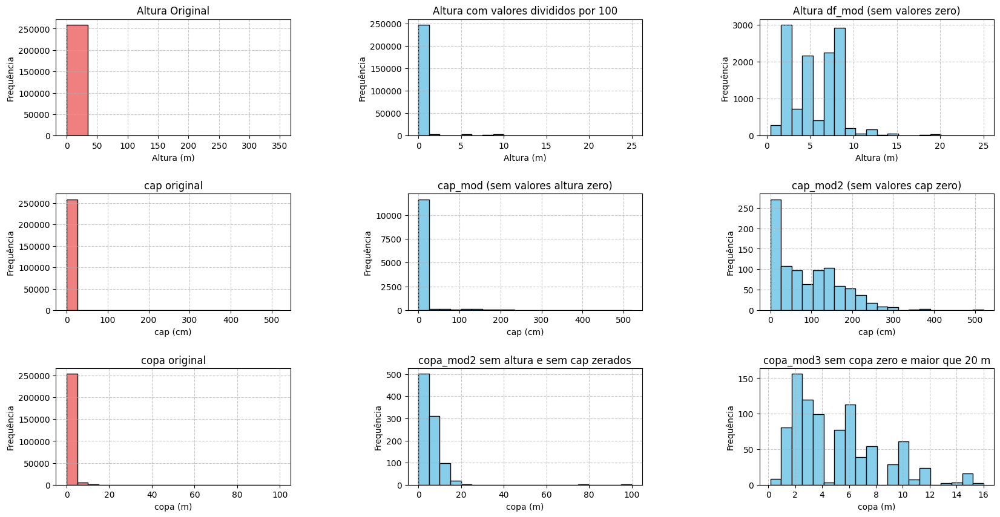

In [35]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.pyplot as plt

# Cria uma figura com dois subgráficos (1 linha, 3 colunas)
fig, axes = plt.subplots(3, 3, figsize=(20, 10))

# Primeiro histograma: altura_original
axes[0,0].hist(df["altura_original"], bins=10, color='lightcoral', edgecolor='black')
axes[0,0].set_title("Altura Original")
axes[0,0].set_xlabel("Altura (m)")
axes[0,0].set_ylabel("Frequência")

# Segundo histograma: altura
axes[0,1].hist(df["altura"], bins=20, color='skyblue', edgecolor='black')
axes[0,1].set_title("Altura com valores divididos por 100")
axes[0,1].set_xlabel("Altura (m)")
axes[0,1].set_ylabel("Frequência")

# terceiro histograma: altura
axes[0,2].hist(df_mod["altura"], bins=20, color='skyblue', edgecolor='black')
axes[0,2].set_title("Altura df_mod (sem valores zero)")
axes[0,2].set_xlabel("Altura (m)")
axes[0,2].set_ylabel("Frequência")

# Primeiro histograma: cap_original
axes[1,0].hist(df["cap"], bins=20, color='lightcoral', edgecolor='black')
axes[1,0].set_title("cap original")
axes[1,0].set_xlabel("cap (cm)")
axes[1,0].set_ylabel("Frequência")

# Primeiro histograma: cap_mod
axes[1,1].hist(df_mod["cap"], bins=20, color='skyblue', edgecolor='black')
axes[1,1].set_title("cap_mod (sem valores altura zero)")
axes[1,1].set_xlabel("cap (cm)")
axes[1,1].set_ylabel("Frequência")

# Primeiro histograma: cap_mod2
axes[1,2].hist(df_mod2["cap"], bins=20, color='skyblue', edgecolor='black')
axes[1,2].set_title("cap_mod2 (sem valores cap zero)")
axes[1,2].set_xlabel("cap (cm)")
axes[1,2].set_ylabel("Frequência")

# Primeiro histograma: copa_original
axes[2,0].hist(df["copa"], bins=20, color='lightcoral', edgecolor='black')
axes[2,0].set_title("copa original")
axes[2,0].set_xlabel("copa (m)")
axes[2,0].set_ylabel("Frequência")

# Primeiro histograma: dap_mod
axes[2,1].hist(df_mod2["copa"], bins=20, color='skyblue', edgecolor='black')
axes[2,1].set_title("copa_mod2 sem altura e sem cap zerados")
axes[2,1].set_xlabel("copa (m)")
axes[2,1].set_ylabel("Frequência")

# Primeiro histograma: copa_mod2
axes[2,2].hist(df_mod3["copa"], bins=20, color='skyblue', edgecolor='black')
axes[2,2].set_title("copa_mod3 sem copa zero e maior que 20 m")
axes[2,2].set_xlabel("copa (m)")
axes[2,2].set_ylabel("Frequência")

for ax in axes.flat:
    ax.grid(True, linestyle='--', alpha=0.7)

plt.subplots_adjust(hspace=0.5, wspace=0.5)
#plt.tight_layout()
plt.show()

Gerando dataframe (df) auxiliar para análise das métricas - criando df_mod4 com as colunas bairro, altura, cap e copa

In [36]:
df_mod3.head(20)

,objectid,porte_especie,bairro,rpa,x,y,nome_popular,categoria,observacao,tipologia,...,id,longitude,latitude,nome_popular_padrao,fitossanid_grupo,injuria_grupo,injuria_corrigida,fitossanid_corrigida,bairro_nome,altura_original
4,1731,MP,IPU,4.0,286350.7576,9.110011e+06,NaN,NaN,NaN,QU,...,1731,286350.7576,9.110011e+06,NaN,Saudável,Não informada,NaN,Saudavel,Iputinga,3.2
20,9086,MP,IPU,4.0,286341.1002,9.110010e+06,NaN,NaN,NaN,QU,...,9086,286341.1002,9.110010e+06,NaN,Saudável,Não informada,NaN,Saudavel,Iputinga,3.3
21,9299,MP,IPU,4.0,286420.0785,9.110014e+06,NaN,NaN,NaN,CL,...,9299,286430.2553,9.110014e+06,NaN,Saudável,Não informada,NaN,Saudavel,Iputinga,2.2
26,10564,MP,IPU,4.0,286391.6358,9.110012e+06,NaN,NaN,NaN,CL,...,10564,286400.4723,9.110012e+06,NaN,Saudável,Não informada,NaN,Saudavel,Iputinga,2.2
27,10680,MP,IPU,4.0,286429.8681,9.110014e+06,NaN,NaN,NaN,CL,...,10680,286438.1906,9.110014e+06,NaN,Saudável,Não informada,NaN,Saudavel,Iputinga,2.1
28,11271,MP,IPU,4.0,286328.2679,9.110011e+06,NaN,NaN,NaN,QU,...,11271,286328.2679,9.110011e+06,NaN,Saudável,Não informada,NaN,Saudavel,Iputinga,4.2
31,11603,MP,IPU,4.0,286410.8181,9.110013e+06,NaN,NaN,NaN,CL,...,11603,286421.1686,9.110013e+06,NaN,Saudável,Não informada,NaN,Saudavel,Iputinga,2.2
71944,108263,GP,VCG,3.0,287966.4559,9.112995e+06,Ipeamarelo,156.0,público,NaN,...,108263,287962.7619,9.112993e+06,Ipê-Amarelo,Saudável,Não informada,NaN,Saudavel,Vasco da Gama,2.6
72239,108558,GP,VCG,3.0,287966.9906,9.112986e+06,Ipeamarelo,156.0,público,NaN,...,108558,287962.9534,9.112982e+06,Ipê-Amarelo,Saudável,Não informada,NaN,Saudavel,Vasco da Gama,2.6
72446,108765,MP,VCG,3.0,287966.5629,9.112999e+06,Pau Brasil,156.0,calçada,NaN,...,108765,287954.5916,9.112986e+06,Pau-Brasil,Saudável,Não informada,NaN,Saudavel,Vasco da Gama,2.7


In [37]:
df_mod4 = df_mod3[["bairro", "altura", "cap", "copa"]]
df_mod4.head(20)

,bairro,altura,cap,copa
4,IPU,3.2,1.000000,1.0
20,IPU,3.3,1.000000,1.0
21,IPU,2.2,1.000000,1.0
26,IPU,2.2,1.000000,1.0
27,IPU,2.1,1.000000,1.0
28,IPU,4.2,1.000000,1.0
31,IPU,2.2,1.000000,1.0
71944,VCG,2.6,1.000000,1.0
72239,VCG,2.6,1.000000,1.0
72446,VCG,2.7,5.000000,3.0


In [38]:
# Modificando os dados da coluna 'cap' de centímetos(cm) para metros(m)
# Criamos uma nova coluna 'cap_metros' para preservar a original se necessário
df_mod4['cap_metros'] = df_mod4['cap'] / 100

/tmp/ipython-input-1680128676.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_mod4['cap_metros'] = df_mod4['cap'] / 100


In [39]:
df_mod4.head(20)

,bairro,altura,cap,copa,cap_metros
4,IPU,3.2,1.000000,1.0,0.010000
20,IPU,3.3,1.000000,1.0,0.010000
21,IPU,2.2,1.000000,1.0,0.010000
26,IPU,2.2,1.000000,1.0,0.010000
27,IPU,2.1,1.000000,1.0,0.010000
28,IPU,4.2,1.000000,1.0,0.010000
31,IPU,2.2,1.000000,1.0,0.010000
71944,VCG,2.6,1.000000,1.0,0.010000
72239,VCG,2.6,1.000000,1.0,0.010000
72446,VCG,2.7,5.000000,3.0,0.050000


# **O Problema: Medir o diâmetro da copa (a "sombra" que a árvore faz) é difícil e caro. Exige visão aérea ou medições complexas em campo. Já medir o CAP (circunferência do tronco) é barato e rápido (basta uma fita métrica).**

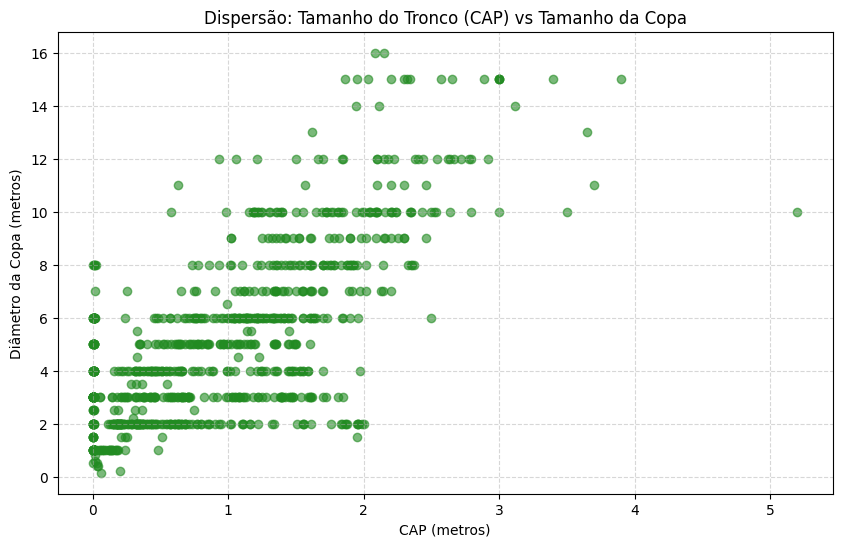

In [40]:
# 2. Criar o Gráfico de Dispersão (Scatter Plot)
plt.figure(figsize=(10, 6))

# Eixo X = cap_metros, Eixo Y = copa
plt.scatter(df_mod4['cap_metros'], df_mod4['copa'], alpha=0.6, color='forestgreen')

plt.title('Dispersão: Tamanho do Tronco (CAP) vs Tamanho da Copa')
plt.xlabel('CAP (metros)')
plt.ylabel('Diâmetro da Copa (metros)')
plt.grid(True, linestyle='--', alpha=0.5)

plt.show()

                            OLS Regression Results                            
Dep. Variable:                   copa   R-squared:                       0.532
Model:                            OLS   Adj. R-squared:                  0.532
Method:                 Least Squares   F-statistic:                     1016.
Date:                Wed, 26 Nov 2025   Prob (F-statistic):          2.10e-149
Time:                        01:43:54   Log-Likelihood:                -1997.3
No. Observations:                 894   AIC:                             3999.
Df Residuals:                     892   BIC:                             4008.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          2.1905      0.118     18.640      0.0

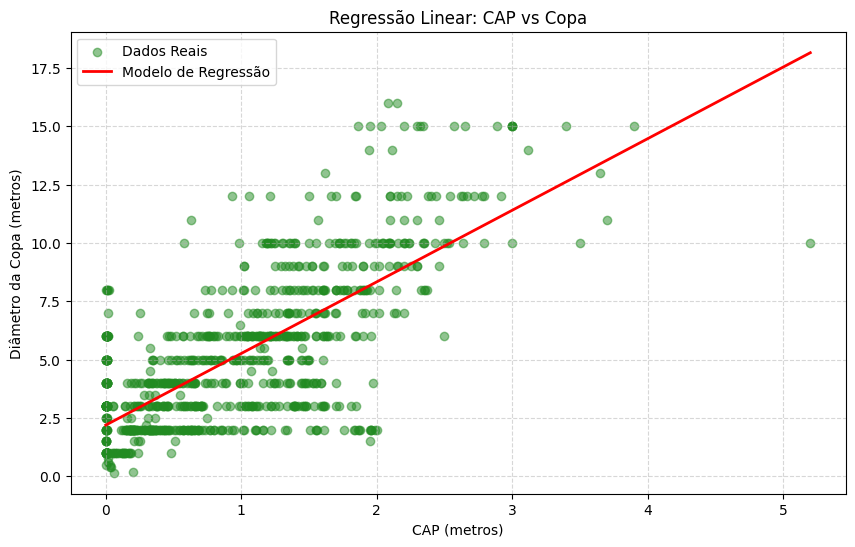

In [41]:
import statsmodels.api as sm
import numpy as np
import matplotlib.pyplot as plt

# 1. Definindo as variáveis
# Variável Independente (X): CAP em metros
X = df_mod4['cap_metros']
# Variável Dependente (y): Copa em metros
y = df_mod4['copa']

# 2. Adicionando a constante (intercepto)
# O statsmodels exige que adicionemos manualmente a coluna de 1s para calcular o beta_0
X_com_constante = sm.add_constant(X)

# 3. Ajustando o Modelo (Fit)
modelo = sm.OLS(y, X_com_constante).fit()

# 4. Imprimindo o "Boletim" Estatístico
print(modelo.summary())

# --- Visualização da Reta ---
# Criando a linha de predição para o gráfico
x_range = np.linspace(X.min(), X.max(), 100)
x_range_const = sm.add_constant(x_range)
y_pred = modelo.predict(x_range_const)

# Plotando tudo junto
plt.figure(figsize=(10, 6))
plt.scatter(df_mod4['cap_metros'], df_mod4['copa'], alpha=0.5, color='forestgreen', label='Dados Reais')
plt.plot(x_range, y_pred, color='red', linewidth=2, label='Modelo de Regressão')

plt.title('Regressão Linear: CAP vs Copa')
plt.xlabel('CAP (metros)')
plt.ylabel('Diâmetro da Copa (metros)')
plt.legend()
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

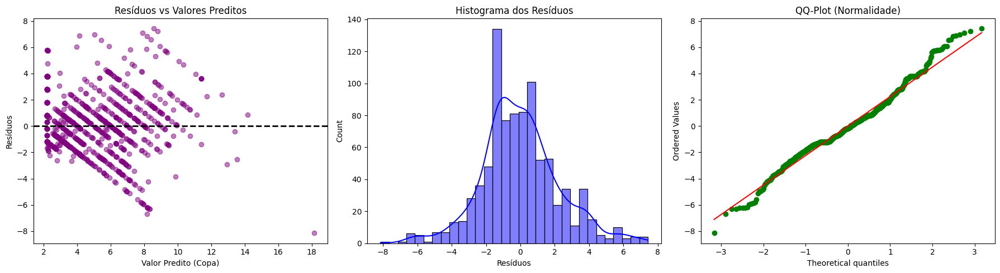

In [42]:
import matplotlib.pyplot as plt
import scipy.stats as stats
import seaborn as sns # Opcional, deixa o histograma mais bonito

# 1. Calculando os resíduos e valores preditos
# (Assumindo que sua variável do modelo anterior se chama 'modelo')
residuos = modelo.resid
y_preditos = modelo.predict()

# Configurando a área de plotagem (3 gráficos)
fig, ax = plt.subplots(1, 3, figsize=(18, 5))

# --- GRÁFICO 1: Resíduos vs Valores Preditos (Verifica Homocedasticidade) ---
ax[0].scatter(y_preditos, residuos, alpha=0.5, color='purple')
ax[0].axhline(y=0, color='black', linestyle='--', linewidth=2)
ax[0].set_title('Resíduos vs Valores Preditos')
ax[0].set_xlabel('Valor Predito (Copa)')
ax[0].set_ylabel('Resíduos')
# O ideal: Uma nuvem aleatória sem forma definida.
# O problema: Se formar um "funil" (leque), temos heterocedasticidade.

# --- GRÁFICO 2: Histograma dos Resíduos (Verifica Normalidade) ---
sns.histplot(residuos, kde=True, ax=ax[1], color='blue')
ax[1].set_title('Histograma dos Resíduos')
ax[1].set_xlabel('Resíduos')
# O ideal: Formato de sino (Sino de Gauss) centrado no zero.

# --- GRÁFICO 3: QQ-Plot (Verifica Normalidade com rigor) ---
stats.probplot(residuos, dist="norm", plot=ax[2])
ax[2].set_title('QQ-Plot (Normalidade)')
ax[2].get_lines()[0].set_color('green') # Pontos
ax[2].get_lines()[1].set_color('red')   # Linha de referência
# O ideal: Os pontos verdes devem seguir a linha vermelha pontilhada.

plt.tight_layout()
plt.show()

**No Gráfico 1 (Resíduos vs Preditos)**:

Você provavelmente verá um formato de cone ou megafone aberto para a direita.

Interpretação: Isso significa que o modelo erra pouco para árvores pequenas, mas erra muito para árvores grandes. Isso se chama Heterocedasticidade.

Impacto: Seu modelo ainda serve para prever a média, mas os intervalos de confiança para árvores grandes não são confiáveis.

**O fenômeno da "Heterocedasticidade" **(O formato de Megafone):Observe que, à esquerda (valores preditos baixos, árvores pequenas), os pontos estão "apertados" perto da linha tracejada.À direita (árvores grandes), os pontos se espalham verticalmente.O que isso significa: Seu modelo é muito mais preciso para árvores pequenas do que para árvores grandes. O erro não é constante. Isso viola uma premissa da regressão linear clássica, embora não invalide totalmente o modelo, apenas torna as previsões para árvores grandes menos confiáveis.

**As "Linhas Diagonais" **(Estriação):Você notou que os pontos roxos formam linhas paralelas perfeitas na diagonal?O Diagnóstico do Professor: Isso ocorre porque sua variável alvo (copa) é discreta ou foi arredondada severamente (provavelmente são números inteiros como 2.0, 3.0, 4.0, sem casas decimais quebradas).Matematicamente: Se $Erro = Y_{real} - Y_{predito}$, e $Y_{real}$ é sempre um número inteiro, o erro segue um padrão linear conforme a predição muda.Impacto: O modelo está tentando ajustar uma reta contínua a degraus de uma escada.


**Nos Gráfico 2 (Histrograma) e 3 (QQ-Plot):**

**Histograma**: Apesar das barras irregulares (culpa do arredondamento dos dados que mencionei acima), a "alma" da distribuição é uma curva de sino (Normal). A linha azul suave mostra que os erros estão centrados em zero. Isso é ótimo!

**QQ-Plot**: A maioria dos pontos verdes segue a linha vermelha. Isso confirma que os erros são majoritariamente normais.

O Alerta: Note a "cauda" superior descolando da linha vermelha e aquele ponto solitário lá embaixo na esquerda. Isso são outliers. O modelo não consegue explicar essas árvores extremas (talvez aquela árvore de tronco grosso e copa pequena).

Se os pontos fugirem da linha vermelha nas pontas (formando um "S"), indica que a distribuição dos erros tem caudas pesadas (existem outliers extremos que o modelo não consegue explicar).

In [43]:
#import numpy as np
#import statsmodels.api as sm
#import matplotlib.pyplot as plt

# 1. Aplicar Logaritmo (Log Natural) nas variáveis
# Adicionamos uma constante pequena (+0.1) só para evitar log(0) caso exista
df_mod4['log_cap'] = np.log(df_mod4['cap_metros'])
df_mod4['log_copa'] = np.log(df_mod4['copa'])

# 2. Nova Regressão Log-Log
X_log = sm.add_constant(df_mod4['log_cap'])
y_log = df_mod4['log_copa']

modelo_log = sm.OLS(y_log, X_log).fit()

print(modelo_log.summary())

# 3. Verifique se o R-quadrado aumentou!
# Geralmente, em dados biológicos, o R² salta significativamente com Log.

                            OLS Regression Results                            
Dep. Variable:               log_copa   R-squared:                       0.296
Model:                            OLS   Adj. R-squared:                  0.295
Method:                 Least Squares   F-statistic:                     375.1
Date:                Wed, 26 Nov 2025   Prob (F-statistic):           5.01e-70
Time:                        01:43:56   Log-Likelihood:                -832.68
No. Observations:                 894   AIC:                             1669.
Df Residuals:                     892   BIC:                             1679.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          1.5820      0.023     68.938      0.0

/tmp/ipython-input-3957064018.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_mod4['log_cap'] = np.log(df_mod4['cap_metros'])
/tmp/ipython-input-3957064018.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_mod4['log_copa'] = np.log(df_mod4['copa'])


                            OLS Regression Results                            
Dep. Variable:                   copa   R-squared:                       0.529
Model:                            OLS   Adj. R-squared:                  0.529
Method:                 Least Squares   F-statistic:                     997.9
Date:                Wed, 26 Nov 2025   Prob (F-statistic):          2.41e-147
Time:                        01:43:56   Log-Likelihood:                -1980.1
No. Observations:                 889   AIC:                             3964.
Df Residuals:                     887   BIC:                             3974.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          2.1176      0.119     17.827      0.0

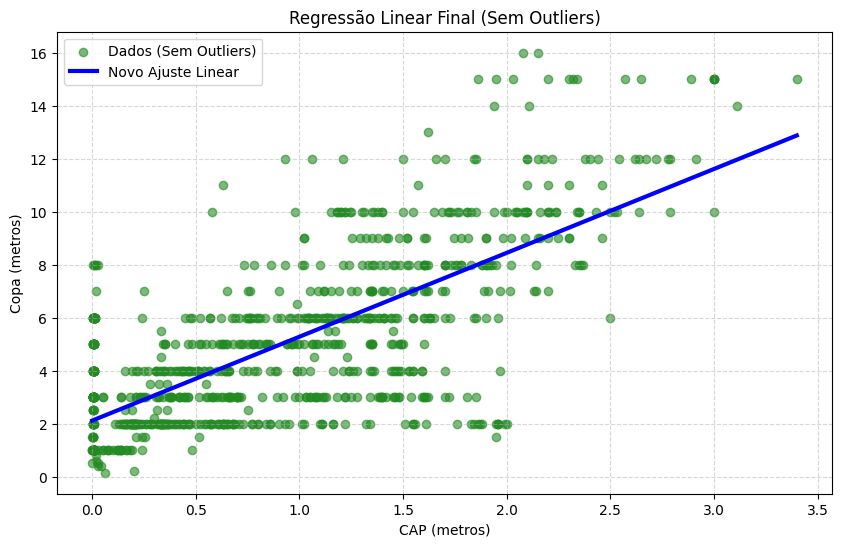

In [44]:
# 1. Removendo Outliers (Filtro conservador)
# Vamos manter apenas árvores com tronco (CAP) menor que 3.5 metros
# Isso deve eliminar aquele ponto isolado na direita
df_final = df_mod4[df_mod4['cap_metros'] < 3.5].copy()

# 2. Configurando o Modelo Linear (Original)
X = df_final['cap_metros']
y = df_final['copa']
X_const = sm.add_constant(X)

# 3. Fit do Modelo
modelo_final = sm.OLS(y, X_const).fit()

# 4. Resultados
print(modelo_final.summary())

# --- Visualização Comparativa ---
plt.figure(figsize=(10, 6))

# Dados Limpos
plt.scatter(df_final['cap_metros'], df_final['copa'],
            alpha=0.6, color='forestgreen', label='Dados (Sem Outliers)')

# Nova Reta de Regressão
x_range = np.linspace(X.min(), X.max(), 100)
y_pred = modelo_final.predict(sm.add_constant(x_range))
plt.plot(x_range, y_pred, color='blue', linewidth=3, label='Novo Ajuste Linear')

# (Opcional) Visualizar onde estava o Outlier antigo (se quiser comparar)
# plt.scatter(df_mod4[df_mod4['cap_metros']>=3.5]['cap_metros'],
#             df_mod4[df_mod4['cap_metros']>=3.5]['copa'], color='red', label='Outliers Removidos')

plt.title('Regressão Linear Final (Sem Outliers)')
plt.xlabel('CAP (metros)')
plt.ylabel('Copa (metros)')
plt.legend()
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

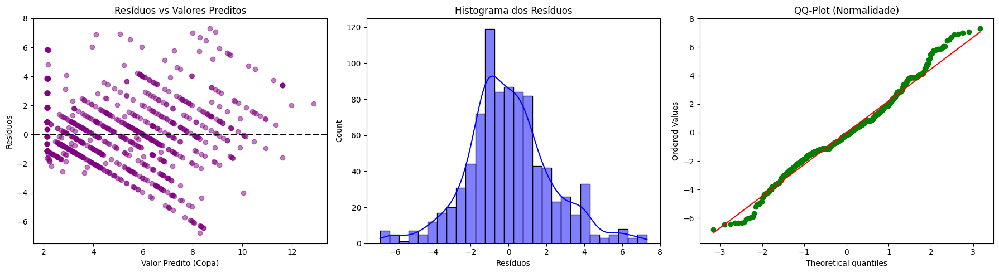

In [45]:
# 1. Calculando os resíduos e valores preditos
# (Assumindo que sua variável do modelo anterior se chama 'modelo')
residuos = modelo_final.resid
y_preditos = modelo_final.predict()

# Configurando a área de plotagem (3 gráficos)
fig, ax = plt.subplots(1, 3, figsize=(18, 5))

# --- GRÁFICO 1: Resíduos vs Valores Preditos (Verifica Homocedasticidade) ---
ax[0].scatter(y_preditos, residuos, alpha=0.5, color='purple')
ax[0].axhline(y=0, color='black', linestyle='--', linewidth=2)
ax[0].set_title('Resíduos vs Valores Preditos')
ax[0].set_xlabel('Valor Predito (Copa)')
ax[0].set_ylabel('Resíduos')
# O ideal: Uma nuvem aleatória sem forma definida.
# O problema: Se formar um "funil" (leque), temos heterocedasticidade.

# --- GRÁFICO 2: Histograma dos Resíduos (Verifica Normalidade) ---
sns.histplot(residuos, kde=True, ax=ax[1], color='blue')
ax[1].set_title('Histograma dos Resíduos')
ax[1].set_xlabel('Resíduos')
# O ideal: Formato de sino (Sino de Gauss) centrado no zero.

# --- GRÁFICO 3: QQ-Plot (Verifica Normalidade com rigor) ---
stats.probplot(residuos, dist="norm", plot=ax[2])
ax[2].set_title('QQ-Plot (Normalidade)')
ax[2].get_lines()[0].set_color('green') # Pontos
ax[2].get_lines()[1].set_color('red')   # Linha de referência
# O ideal: Os pontos verdes devem seguir a linha vermelha pontilhada.

plt.tight_layout()
plt.show()

**O modelo é estatisticamente sólido para estimar médias gerais da cidade. Ele confirma que o tronco (CAP) é um excelente preditor da sombra (Copa), mas possui uma margem de erro natural que aumenta em árvores muito grandes, devido à variabilidade biológica e intervenções humanas (podas)**

In [46]:
# Vamos extrair os "Presentes" do modelo para a Prefeitura

# 1. Os Coeficientes da Reta (A Fórmula)
beta_0 = modelo_final.params['const']
beta_1 = modelo_final.params['cap_metros']

# 2. O Erro Médio (RMSE - Root Mean Squared Error)
# Diz, em média, quantos metros o modelo "erra" para cima ou para baixo
rmse = np.sqrt(modelo_final.mse_resid)

print("=== RELATÓRIO FINAL PARA A PREFEITURA ===")
print(f"Fórmula de Estimação: Copa (m) = {beta_0:.2f} + {beta_1:.2f} * CAP(m)")
print(f"Margem de Erro Média (RMSE): +/- {rmse:.2f} metros")
print(f"Interpretação: A cada 1 metro de tronco a mais, a copa cresce {beta_1:.2f} metros.")

=== RELATÓRIO FINAL PARA A PREFEITURA ===
Fórmula de Estimação: Copa (m) = 2.12 + 3.16 * CAP(m)
Margem de Erro Média (RMSE): +/- 2.25 metros
Interpretação: A cada 1 metro de tronco a mais, a copa cresce 3.16 metros.


**TAREFA DE CLASSIFICAÇÃO**

Nova Pergunta (Classificação): "Esta árvore tem uma copa GRANDE (que precisa de poda urgente)?"

Vamos criar uma "linha de corte". Digamos que a Prefeitura define que qualquer árvore com copa maior que 6 metros é considerada "Classe 1 (Grande/Risco)" e o resto é "Classe 0 (Normal)".

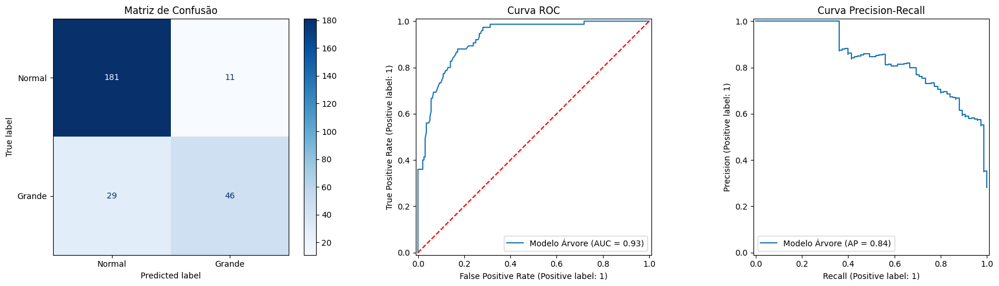

=== RELATÓRIO DE CLASSIFICAÇÃO ===
              precision    recall  f1-score   support

      Normal       0.86      0.94      0.90       192
      Grande       0.81      0.61      0.70        75

    accuracy                           0.85       267
   macro avg       0.83      0.78      0.80       267
weighted avg       0.85      0.85      0.84       267



In [47]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import (confusion_matrix, ConfusionMatrixDisplay,
                             classification_report, roc_curve, auc,
                             PrecisionRecallDisplay, RocCurveDisplay)

# 1. PREPARAR OS DADOS (Pivotar para Classificação)
# Vamos definir que Copa > 6m é "Grande" (Classe 1)
# Usaremos o df_final (sem outliers) que criamos antes
df_class = df_final.copy()
df_class['categoria_copa'] = np.where(df_class['copa'] > 6, 1, 0) # 1 = Grande, 0 = Normal

# Definir X e y
X = df_class[['cap_metros']] # O Classificador precisa de array 2D
y = df_class['categoria_copa']

# Dividir em Treino e Teste (Essencial para avaliação de classificadores)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# 2. TREINAR O CLASSIFICADOR (Regressão Logística)
clf = LogisticRegression()
clf.fit(X_train, y_train)

# Fazer predições
y_pred = clf.predict(X_test)
y_prob = clf.predict_proba(X_test)[:, 1] # Probabilidade de ser "Grande"

# --- 3. GERAÇÃO DAS VISUALIZAÇÕES PEDIDAS ---

fig, ax = plt.subplots(1, 3, figsize=(18, 5))

# A) Matriz de Confusão
ConfusionMatrixDisplay.from_predictions(y_test, y_pred, ax=ax[0], cmap='Blues',
                                        display_labels=['Normal', 'Grande'])
ax[0].set_title('Matriz de Confusão')

# B) Curva ROC
RocCurveDisplay.from_predictions(y_test, y_prob, ax=ax[1], name='Modelo Árvore')
ax[1].set_title('Curva ROC')
ax[1].plot([0, 1], [0, 1], 'r--') # Linha do acaso

# C) Curva Precision-Recall
PrecisionRecallDisplay.from_predictions(y_test, y_prob, ax=ax[2], name='Modelo Árvore')
ax[2].set_title('Curva Precision-Recall')

plt.tight_layout()
plt.show()

# --- 4. ANÁLISE TEXTUAL DAS MÉTRICAS ---
print("=== RELATÓRIO DE CLASSIFICAÇÃO ===")
print(classification_report(y_test, y_pred, target_names=['Normal', 'Grande']))

Definição do Problema: "Para auxiliar a gestão de riscos, transformamos o problema em uma classificação binária, visando identificar automaticamente árvores de grande porte (Copa > 6m) baseadas apenas na medida do tronco."

Acurácia (Accuracy): "O modelo acertou X% das previsões totais." (Cuidado: se tivermos poucas árvores grandes, a acurácia engana. Olhe o F1).

Recall (Sensibilidade): Esta é a métrica mais importante para a Prefeitura.

"O Recall da classe 'Grande' nos diz: Das árvores que realmente eram gigantes, quantas o modelo conseguiu detectar? Se o Recall for baixo, estamos deixando árvores perigosas sem vistoria."

Precisão: "Das árvores que o modelo gritou que eram grandes, quantas realmente eram? Se for baixa, a prefeitura vai gastar dinheiro mandando equipe técnica para árvores que na verdade são pequenas (falso alarme)."

Curva ROC: "A curva mostra a capacidade de separação do modelo. Quanto mais próxima do canto superior esquerdo, melhor o modelo consegue distinguir árvores grandes de pequenas sem confundir."

1. A Matriz de Confusão (O Placar do Jogo)
O primeiro quadro azul é o resumo dos acertos e erros do nosso estagiário em 267 árvores testadas.

O que ele acertou (A Diagonal Principal):

181 Árvores Normais: Ele disse que eram normais e realmente eram. (Ótimo!)

46 Árvores Grandes: Ele disse que eram grandes e realmente eram.

Total de Acertos: 227 árvores.

Onde ele errou (A Diagonal Secundária):

11 Alarmes Falsos: Ele gritou "É GRANDE!", mas quando a equipe foi lá, era uma árvore normal. (Gasto desnecessário de visita).

29 Omissões Perigosas: Esse é o número crítico. Eram árvores Grandes, mas ele disse que eram normais. O sistema "deixou passar" 29 árvores grandes.

2. O Boletim de Notas (Métricas)
Aqui traduzimos os números da tabela abaixo da matriz:

Acurácia (85%): É a nota geral da prova. De cada 100 árvores, ele acerta a classificação de 85. É uma nota boa, mas esconde detalhes.

Precisão ("Confiança no Alerta" - 0.81): Quando o sistema diz "Essa árvore é GRANDE", ele está certo em 81% das vezes. Ou seja, ele raramente dá alarme falso. A Prefeitura pode confiar que, se ele mandou visitar, provavelmente é grande mesmo.

Recall ("Sensibilidade" - 0.61): Aqui está o ponto fraco. De todas as árvores grandes que existem na cidade, ele só conseguiu encontrar 61%. Quase 40% das árvores grandes passaram despercebidas pelo radar dele.

Resumo Prático: O sistema é conservador. Ele só dá o alerta quando tem muita certeza. Isso economiza dinheiro (poucas visitas inúteis), mas pode ser perigoso (deixa árvores grandes sem vistoria).

3. A Curva ROC (O Potencial do Modelo)
Olhe para o gráfico do meio (a linha azul curvada).

A Linha Vermelha Pontilhada seria se estivéssemos chutando "cara ou coroa".

A Linha Azul é o nosso modelo. Quanto mais ela sobe para o canto superior esquerdo, melhor.

A Nota (AUC = 0.93): O número 0.93 (de um máximo de 1.0) diz que o modelo é EXCELENTE em distinguir matematicamente uma árvore grande de uma pequena.

"Espere, se ele é excelente (0.93), por que ele errou tantas árvores grandes (Recall 0.61)?" Porque a "régua" de corte está muito rígida. Como ele é excelente, nós podemos, no futuro, pedir para ele ser "menos rigoroso". Ele vai detectar quase todas as árvores grandes, mas vai começar a dar alguns alarmes falsos a mais. A curva ROC nos diz que é possível fazer esse ajuste com sucesso.

Conclusão para o Gestor (Texto Final Sugerido)
"O modelo desenvolvido demonstrou alta capacidade técnica (AUC de 0.93) para distinguir o porte das árvores apenas pelo diâmetro do tronco. Atualmente, ele opera com uma precisão de 81%, o que significa que ele é muito eficiente em direcionar as equipes de poda sem desperdiçar recursos com vistorias desnecessárias.

No entanto, na configuração atual, o sistema prioriza a economia de recursos e acaba não detectando cerca de 39% das árvores de grande porte (Recall de 0.61). Para fins de segurança pública (evitar queda de árvores), recomenda-se um ajuste no sistema para torná-lo mais sensível, aceitando-se um leve aumento nas vistorias em troca de garantir que nenhuma árvore grande passe despercebida."

**7. Análise de variáveis espaciais**

Análise em todas as RPAs - df

In [48]:
import pandas as pd
import numpy as np

# =============================================
# ANÁLISE DAS VARIÁVEIS ESPACIAIS
# =============================================

espaciais = ["x", "y", "latitude", "longitude", "x_wgs84", "y_wgs84"]

print("=== Tipos e nulos ===")
print(df[espaciais].info())
print("\nValores nulos por coluna:")
print(df[espaciais].isna().sum())

# Estatísticas descritivas
print("\n=== Estatísticas descritivas ===")
print(df[espaciais].describe().T)

# Diferenças entre colunas equivalentes
df["dif_long"] = (df["longitude"] - df["x_wgs84"]).abs()
df["dif_lat"]  = (df["latitude"] - df["y_wgs84"]).abs()

print("\n=== Diferença entre coordenadas duplicadas (longitude/x_wgs84 e latitude/y_wgs84) ===")
print(df[["dif_long", "dif_lat"]].describe())

# Amostra de possíveis inconsistências
print("\n=== Amostras com diferença significativa (>0.0001) ===")
erros = df[(df["dif_long"] > 0.0001) | (df["dif_lat"] > 0.0001)]
print(erros[["longitude", "x_wgs84", "latitude", "y_wgs84"]].head(10))

# Faixas plausíveis de Recife
print("\n=== Faixas esperadas para Recife ===")
print("Longitude: entre -35.05 e -34.80")
print("Latitude : entre  -8.10 e  -7.90")

# Filtra registros fora do Recife (coordenadas incorretas)
fora_recife = df[
    (df["longitude"] < -35.05) | (df["longitude"] > -34.80) |
    (df["latitude"]  <  -8.10) | (df["latitude"]  >  -7.90)
]
print(f"\nRegistros fora da faixa geográfica esperada: {len(fora_recife)}")

=== Tipos e nulos ===
<class 'pandas.core.frame.DataFrame'>
Index: 259492 entries, 0 to 259563
Data columns (total 6 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   x          259492 non-null  float64
 1   y          259492 non-null  float64
 2   latitude   259492 non-null  float64
 3   longitude  259492 non-null  float64
 4   x_wgs84    259492 non-null  float64
 5   y_wgs84    259492 non-null  float64
dtypes: float64(6)
memory usage: 13.9 MB
None

Valores nulos por coluna:
x            0
y            0
latitude     0
longitude    0
x_wgs84      0
y_wgs84      0
dtype: int64

=== Estatísticas descritivas ===
              count          mean          std           min           25%  \
x          259492.0  2.875864e+05  3150.014980  2.786658e+05  2.852884e+05   
y          259492.0  9.110711e+06  4549.772006  9.098074e+06  9.108352e+06   
latitude   259492.0  9.110711e+06  4549.771693  9.098074e+06  9.108352e+06   
longitude  259492.0  2.

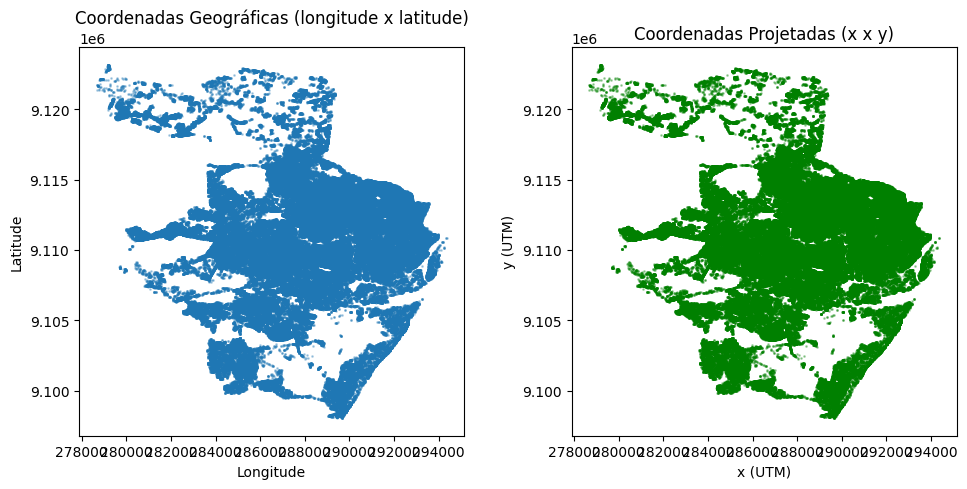

In [49]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10,5))

# Mapa em latitude/longitude
plt.subplot(1,2,1)
plt.scatter(df["longitude"], df["latitude"], s=1, alpha=0.3)
plt.title("Coordenadas Geográficas (longitude x latitude)")
plt.xlabel("Longitude")
plt.ylabel("Latitude")

# Mapa em UTM
plt.subplot(1,2,2)
plt.scatter(df["x"], df["y"], s=1, alpha=0.3, color="green")
plt.title("Coordenadas Projetadas (x x y)")
plt.xlabel("x (UTM)")
plt.ylabel("y (UTM)")

plt.tight_layout()
plt.show()


In [50]:
from pyproj import Transformer
import folium
from folium.plugins import FastMarkerCluster

# 1) Filtrar RPAs válidas e coordenadas existentes
df_mapa = df[df['rpa'].between(1, 6)].copy()
df_mapa = df_mapa[df_mapa['x'].notna() & df_mapa['y'].notna()]

# 2) Converter de UTM 25S para WGS84 (lon/lat)
# Tente primeiro SIRGAS2000/UTM 25S (EPSG:31985). Se ficar estranho, use WGS84/UTM 25S (EPSG:32725).
transformer = Transformer.from_crs("EPSG:31985", "EPSG:4326", always_xy=True)
# Se necessário, troque para:
# transformer = Transformer.from_crs("EPSG:32725", "EPSG:4326", always_xy=True)

lon, lat = transformer.transform(df_mapa['x'].values, df_mapa['y'].values)
df_mapa['lon'] = lon
df_mapa['lat'] = lat

# Checagem rápida: deve dar ~ (-34.9, -8.0)
df_mapa[['lon','lat']].head()

,lon,lat
0,-34.948087,-7.930653
1,-34.930934,-8.016163
3,-34.884382,-8.042639
4,-34.938620,-8.046906
5,-34.884222,-8.042803


In [51]:
# 3) Mapa interativo em Recife
center_all = [df_mapa['lat'].mean(), df_mapa['lon'].mean()]
m_all = folium.Map(location=center_all, zoom_start=12, tiles="CartoDB positron")

locs = df_mapa[['lat','lon']].values.tolist()
FastMarkerCluster(locs).add_to(m_all)

m_all

In [52]:
# Importar o plugin do HeatMap
from folium.plugins import HeatMap

# 1. Criar o mapa base (usando a variável 'center' que você já tem)
m_calor_all = folium.Map(location=center_all, zoom_start=12, tiles="CartoDB positron")

# 2. Adicionar APENAS a camada de calor (usando a variável 'locs')
HeatMap(
    data=locs,
    radius=10,      # Raio de influência de cada ponto
    blur=15,        # Nível de "borrão" (suavização)
    min_opacity=0.4 # Opacidade mínima das áreas "frias"
).add_to(m_calor_all)

# 3. Exibir o mapa
m_calor_all

In [53]:
from folium.plugins import FastMarkerCluster, HeatMap
from pyproj import Transformer


# --- Preparação dos Dados ---

# 1) Filtrar RPAs válidas (1 a 6) e coordenadas existentes
df_mapa = df[df['rpa'].between(1, 6)].copy()
df_mapa = df_mapa[df_mapa['x'].notna() & df_mapa['y'].notna()]

# 2) Converter de UTM 25S (EPSG:31985) para WGS84 (lon/lat)
try:
    # Tentar SIRGAS 2000 / UTM zone 25S
    transformer = Transformer.from_crs("EPSG:31985", "EPSG:4326", always_xy=True)
    lon, lat = transformer.transform(df_mapa['x'].values, df_mapa['y'].values)
    df_mapa['lon'] = lon
    df_mapa['lat'] = lat
except Exception as e:
    print(f"Erro na transformação com EPSG:31985: {e}")
    print("Tentando com WGS 84 / UTM zone 25S (EPSG:32725)...")
    # Tentar WGS 84 / UTM zone 25S
    transformer_wgs = Transformer.from_crs("EPSG:32725", "EPSG:4326", always_xy=True)
    lon, lat = transformer_wgs.transform(df_mapa['x'].values, df_mapa['y'].values)
    df_mapa['lon'] = lon
    df_mapa['lat'] = lat

print("Verificação das coordenadas (lat, lon):")
print(df_mapa[['lat', 'lon']].head())

# --- Criação do Mapa ---

# 3) Criar o mapa interativo para Recife (cidade inteira)
center = [df_mapa['lat'].mean(), df_mapa['lon'].mean()]
m_recife_geral = folium.Map(location=center, zoom_start=12, tiles="CartoDB positron")

# 4) Adicionar a camada de Mapa de Calor (HeatMap)
# Prepara os dados para o HeatMap: lista de [lat, lon]
heat_data = df_mapa[['lat', 'lon']].values.tolist()
HeatMap(
    heat_data,
    name="Mapa de Calor (Densidade)",
    radius=10,
    blur=15,
    min_opacity=0.4
).add_to(m_recife_geral)

# 5) Adicionar a camada de Cluster (Contagem)
# Prepara os dados para o Cluster: lista de [lat, lon]
cluster_data = df_mapa[['lat', 'lon']].values.tolist()
FastMarkerCluster(
    cluster_data,
    name="Clusters (Contagem)"
).add_to(m_recife_geral)

# 6) Adicionar controle de camadas (para ligar/desligar o heatmap ou cluster)
folium.LayerControl().add_to(m_recife_geral)

# --- Salvar e Exibir ---

# 7) Salvar o mapa em um arquivo HTML
mapa_filename = "mapa_recife_geral_cluster_heatmap.html"
m_recife_geral.save(mapa_filename)

print(f"\nMapa de Recife inteiro salvo como: {mapa_filename}")

# 8) Para exibir o mapa diretamente no Colab, basta colocar 'm_recife_geral'
#    como a última linha da célula
m_recife_geral

Verificação das coordenadas (lat, lon):
        lat        lon
0 -7.930653 -34.948087
1 -8.016163 -34.930934
3 -8.042639 -34.884382
4 -8.046906 -34.938620
5 -8.042803 -34.884222

Mapa de Recife inteiro salvo como: mapa_recife_geral_cluster_heatmap.html


In [54]:
# Dicionário de nomes
nomes_rpa = {
    1: 'RPA 1 - Centro',
    2: 'RPA 2 - Norte',
    3: 'RPA 3 - Noroeste',
    4: 'RPA 4 - Oeste',
    5: 'RPA 5 - Sudoeste',
    6: 'RPA 6 - Sul'
}

# Cria a nova coluna com o nome completo da RPA
df['rpa_nome'] = df['rpa'].map(nomes_rpa)

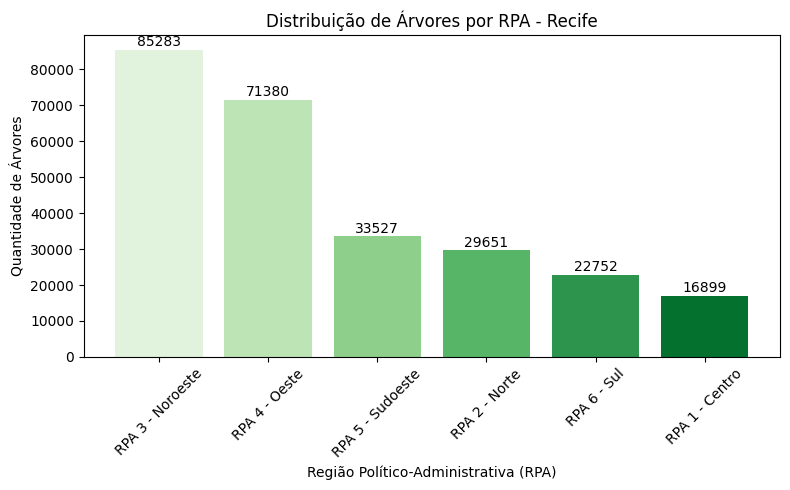

In [55]:
import seaborn as sns

# Agrupar a quantidade de árvores por RPA nome
arvores_por_rpa = df.groupby('rpa_nome').size().reset_index(name='quantidade')

# Ordenar pela quantidade
arvores_por_rpa = arvores_por_rpa.sort_values(by='quantidade', ascending=False)

# Definir paleta de cores em tons de verde
cores = sns.color_palette("Greens", len(arvores_por_rpa))

plt.figure(figsize=(8,5))
barras = plt.bar(arvores_por_rpa['rpa_nome'], arvores_por_rpa['quantidade'], color=cores)

# Adicionar rótulos de quantidade em cima das barras
for barra in barras:
    altura = barra.get_height()
    plt.text(barra.get_x() + barra.get_width()/2, altura + 200,  # ajuste o +200 se quiser subir/baixar o número
             f'{int(altura)}', ha='center', va='bottom', fontsize=10)

plt.xlabel('Região Político-Administrativa (RPA)')
plt.ylabel('Quantidade de Árvores')
plt.title('Distribuição de Árvores por RPA - Recife')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [56]:

# 1) Escolher a coluna de nome (prioriza 'bairro_nome'; senão usa 'bairro' mesmo)
nome_col = 'bairro_nome' if 'bairro_nome' in df.columns else 'bairro'

# 2) Dicionário com os nomes das RPAs
rpa_nome = {1: 'Centro', 2: 'Norte', 3: 'Noroeste', 4: 'Oeste', 5: 'Sudoeste', 6: 'Sul'}

# 3) Contagem de ocorrências por RPA e bairro
contagem = (
    df.groupby(['rpa', nome_col])
      .size()
      .reset_index(name='qtd')
)

# 4) Selecionar os 3 bairros mais frequentes por RPA
top3_por_rpa = (
    contagem.sort_values(['rpa', 'qtd', nome_col], ascending=[True, False, True])
            .groupby('rpa')
            .head(3)
)

# 5) Agregar em uma linha por RPA (lista -> string)
resultado = (
    top3_por_rpa.groupby('rpa')[nome_col]
                .apply(lambda s: ', '.join(s.tolist()))
                .reset_index(name='bairros_exemplo')
)

# 6) Adicionar o nome da RPA
resultado['rpa_nome'] = resultado['rpa'].map(rpa_nome)

# 7) Reordenar colunas
resultado = resultado[['rpa', 'rpa_nome', 'bairros_exemplo']].sort_values('rpa').reset_index(drop=True)

# Mostrar o resultado
resultado


,rpa,rpa_nome,bairros_exemplo
0,1.0,Centro,"Santo Amaro, Boa Vista, Recife"
1,2.0,Norte,"Campo Grande, Dois Unidos, Água Fria"
2,3.0,Noroeste,"Guabiraba, Passarinho, Nova Descoberta"
3,4.0,Oeste,"Várzea, Iputinga, Cordeiro"
4,5.0,Sudoeste,"Jardim São Paulo, Curado, Barro"
5,6.0,Sul,"Boa Viagem, Cohab, Pina"


In [57]:
# escolher coluna de bairro (nome completo se existir)
label_col = 'bairro_nome' if 'bairro_nome' in df.columns else 'bairro'

# agrupar e contar
tabela_arvores = (
    df.groupby(['rpa', label_col])
      .size()
      .reset_index(name='quantidade_arvores')
      .sort_values(['rpa', 'quantidade_arvores'], ascending=[True, False])
      .reset_index(drop=True)
)

# visualizar primeiras linhas
tabela_arvores.head(20)

,rpa,bairro_nome,quantidade_arvores
0,1.0,Santo Amaro,7325
1,1.0,Boa Vista,2908
2,1.0,Recife,1546
3,1.0,São José,1100
4,1.0,Cabanga,842
5,1.0,Ilha Joana Bezerra,837
6,1.0,Soledade,654
7,1.0,Paissandu,511
8,1.0,Ilha do Leite,433
9,1.0,Coelhos,373


**CONFERIR, POIS O CÓDIGO ABAIXO ESTÁ PEGANDO O PATH DO CSV ORIGINAL E AQUI TRABALHAMOS NO df E df_mod3**

In [58]:
import pandas as pd
import folium
import json
#import warnings

# --- 1. CONECTAR AO GOOGLE DRIVE ---
#from google.colab import drive
#try:
    # Montar o Drive
    #drive.mount('/content/drive', force_remount=True) # Forçar remontagem
#except Exception as e:
    #print(f"Aviso: Não foi possível montar o Google Drive. {e}")

# Ignorar o DtypeWarning
#warnings.simplefilter(action='ignore', category=pd.errors.DtypeWarning)

# --- 2. Definir Caminhos e Carregar o CSV ---
#caminho_csv = "/content/drive/Shareddrives/Projetos 5 - G3/Projetos 5 - G3/SR2/Entregáveis - CC/Dataset/censo_arboreo_final_geral.csv"
geojson_path = "/content/drive/Shareddrives/Projetos 5 - G3/Projetos 5 - G3/SR2/Entregáveis - CC/Dataset/rpa.geojson" # <-- Usando o arquivo que você subiu

#try:
    #df = pd.read_csv(caminho_csv, encoding='utf-8', low_memory=False)
#except Exception as e:
    #print(f"Erro ao ler o CSV com utf-8: {e}")
    #raise e

#print("CSV carregado. Processando dados por RPA...")

# --- 3. Lógica de Categorização (por RPA) ---
df_mapa = df[df['rpa'].between(1, 6)].copy()
df_mapa['rpa'] = df_mapa['rpa'].astype(int)
df_mapa['status_saude'] = df_mapa['fitossanid_corrigida'].fillna('Não informada')

def categorizar_saude(status):
    if status in ['Saudável', 'Saudavel']:
        return 'Saudável'
    if status in ['Não informada', 'Não avaliada']:
        return 'Não Informada'
    else:
        return 'Não Saudável'

df_mapa['status_mapa'] = df_mapa['status_saude'].apply(categorizar_saude)

# --- 4. Agregar Dados por RPA ---
df_agg = df_mapa.groupby('rpa')['status_mapa'].value_counts().unstack(fill_value=0)

for col in ['Saudável', 'Não Saudável', 'Não Informada']:
    if col not in df_agg.columns:
        df_agg[col] = 0

df_agg['total_arvores'] = df_agg['Saudável'] + df_agg['Não Saudável'] + df_agg['Não Informada']
df_rpa_agg = df_agg.reset_index()

print("--- Tabela de Contagem por RPA (para o Dashboard) ---")
print(df_rpa_agg.to_markdown(index=False))
print("---------------------------------------------------------")


# --- 5. Carregar e Preparar o GeoJSON (para Popups) ---
try:
    with open(geojson_path, 'r', encoding='utf-8') as f:
        geo_data = json.load(f)
except Exception as e:
    print(f"!!! ERRO ao ler 'rpa.geojson' do Drive: {e}")
    raise e

key_geojson = 'feature.properties.RPA'
data_dict = df_rpa_agg.set_index('rpa').to_dict('index')

# Injetar os dados de contagem nas 'properties' do GeoJSON
# (Isso é necessário para as camadas de COR e para o POPUP)
for feature in geo_data['features']:
    rpa_num = feature['properties']['RPA']
    rpa_data = data_dict.get(rpa_num)

    if rpa_data:
        feature['properties']['Saudável'] = rpa_data['Saudável']
        feature['properties']['Não Saudável'] = rpa_data['Não Saudável']
        feature['properties']['Não Informada'] = rpa_data['Não Informada']
        feature['properties']['total_arvores'] = rpa_data['total_arvores']
    else:
        feature['properties']['Saudável'] = 0
        feature['properties']['Não Saudável'] = 0
        feature['properties']['Não Informada'] = 0
        feature['properties']['total_arvores'] = 0

print(f"\nSucesso! GeoJSON das RPAs preparado com os dados.")

# --- 6. Criar o Mapa e as Camadas de Cor (Choropleth) ---
center = [-8.05428, -34.8813]
m = folium.Map(
    location=center,
    zoom_start=11,
    tiles="CartoDB positron",
    zoom_control=False  # <-- remove a barra de zoom
)

# Camada 1: Visão Observador (Cor)
folium.Choropleth(
    geo_data=geo_data, # <-- Usando a variável geo_data
    name='Cor: Não Saudáveis',
    data=df_rpa_agg,
    columns=['rpa', 'Não Saudável'],
    key_on=key_geojson,
    fill_color='Reds',
    fill_opacity=0.7,
    line_opacity=0.4,
    legend_name='Contagem de Árvores "Não Saudáveis"',
    show=True,
    highlight=False # Desligar highlight para não conflitar
).add_to(m)

# Camada 2: Visão Pesque (Cor)
folium.Choropleth(
    geo_data=geo_data,
    name='Cor: Não Informada',
    data=df_rpa_agg,
    columns=['rpa', 'Não Informada'],
    key_on=key_geojson,
    fill_color='Greys',
    fill_opacity=0.7,
    line_opacity=0.4,
    legend_name='Contagem de Árvores "Não Informadas"',
    show=False,
    highlight=False
).add_to(m)

# Camada 3: Visão Contexto (Cor)
folium.Choropleth(
    geo_data=geo_data,
    name='Cor: Saudáveis',
    data=df_rpa_agg,
    columns=['rpa', 'Saudável'],
    key_on=key_geojson,
    fill_color='Greens',
    fill_opacity=0.7,
    line_opacity=0.4,
    legend_name='Contagem de Árvores "Saudáveis"',
    show=False,
    highlight=False
).add_to(m)

# --- 7. (NOVO) Adicionar Camada de POPUP (Informação ao Clicar) ---
# Esta camada fica por cima de tudo e controla os cliques
popup_layer = folium.GeoJson(
    geo_data, # <-- O GeoJSON modificado com os dados
    name='Informações (Clique na RPA)',
    # Estilo: borda amarela ao passar o mouse, preenchimento leve
    style_function=lambda x: {'fillOpacity': 0.1, 'color': '#555', 'weight': 1},
    highlight_function=lambda x: {'weight': 3, 'color': 'yellow', 'fillOpacity': 0.2},
    popup=folium.GeoJsonPopup(
        # Usar os nomes de propriedades que injetamos
        fields=['RPA', 'total_arvores', 'Não Saudável', 'Não Informada', 'Saudável'],
        aliases=['RPA:', 'Total de Árvores:', 'Não Saudável:', 'Não Informada:', 'Saudável:'],
        localize=True,
        sticky=False, # O popup não fica 'colado' no mouse
    )
)
popup_layer.add_to(m)

# --- 8. Adicionar Controle e Exibir ---
folium.LayerControl().add_to(m)

mapa_filename = "mapa_coropletico_RPA_com_POPUP.html"
m.save(mapa_filename)

print(f"\nMapa Coroplético por RPA com Popups salvo como: {mapa_filename}")

m

--- Tabela de Contagem por RPA (para o Dashboard) ---
|   rpa |   Não Informada |   Não Saudável |   Saudável |   total_arvores |
|------:|----------------:|---------------:|-----------:|----------------:|
|     1 |           15821 |           1039 |         39 |           16899 |
|     2 |           29218 |            148 |        285 |           29651 |
|     3 |           84565 |            637 |         81 |           85283 |
|     4 |           71279 |              2 |         99 |           71380 |
|     5 |           33521 |              1 |          5 |           33527 |
|     6 |           22727 |              2 |         23 |           22752 |
---------------------------------------------------------

Sucesso! GeoJSON das RPAs preparado com os dados.

Mapa Coroplético por RPA com Popups salvo como: mapa_coropletico_RPA_com_POPUP.html


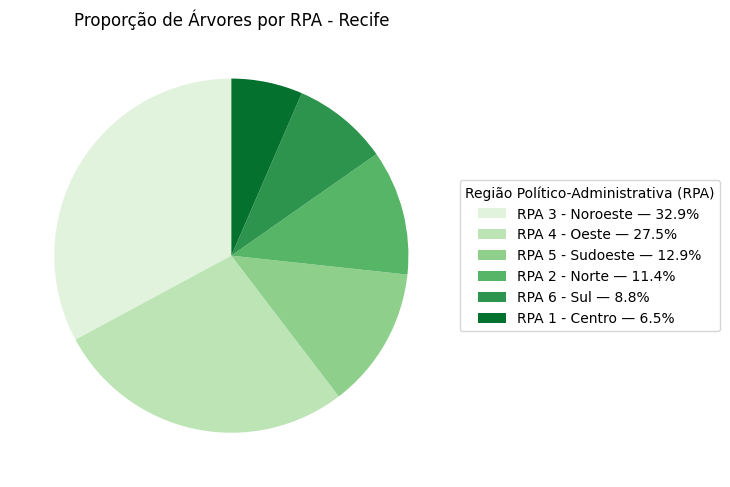

In [59]:
# Calcular as porcentagens manualmente
arvores_por_rpa['percentual'] = (arvores_por_rpa['quantidade'] / arvores_por_rpa['quantidade'].sum()) * 100

# Criar rótulos combinando nome + percentual
rotulos_legenda = [f"{rpa} — {p:.1f}%" for rpa, p in zip(arvores_por_rpa['rpa_nome'], arvores_por_rpa['percentual'])]

plt.figure(figsize=(7,6))
# Criar a pizza sem exibir porcentagens dentro
wedges, texts = plt.pie(arvores_por_rpa['quantidade'],
                        labels=None,       # sem labels diretos
                        startangle=90,
                        colors=cores)

# Adicionar legenda personalizada
plt.legend(wedges, rotulos_legenda,
           title="Região Político-Administrativa (RPA)",
           loc="center left", bbox_to_anchor=(1, 0.5))

plt.title("Proporção de Árvores por RPA - Recife")
plt.tight_layout()
plt.show()


Análise na região que contém árvores com métricas mapeadas

In [60]:
import pandas as pd
import numpy as np

# =============================================
# ANÁLISE DAS VARIÁVEIS ESPACIAIS
# =============================================

espaciais = ["x", "y", "latitude", "longitude", "x_wgs84", "y_wgs84"]

print("=== Tipos e nulos ===")
print(df_mod3[espaciais].info())
print("\nValores nulos por coluna:")
print(df_mod3[espaciais].isna().sum())

# Estatísticas descritivas
print("\n=== Estatísticas descritivas ===")
print(df_mod3[espaciais].describe().T)

# Diferenças entre colunas equivalentes
df_mod3["dif_long"] = (df_mod3["longitude"] - df_mod3["x_wgs84"]).abs()
df_mod3["dif_lat"]  = (df_mod3["latitude"] - df_mod3["y_wgs84"]).abs()

print("\n=== Diferença entre coordenadas duplicadas (longitude/x_wgs84 e latitude/y_wgs84) ===")
print(df_mod3[["dif_long", "dif_lat"]].describe())

# Amostra de possíveis inconsistências
print("\n=== Amostras com diferença significativa (>0.0001) ===")
erros = df_mod3[(df_mod3["dif_long"] > 0.0001) | (df_mod3["dif_lat"] > 0.0001)]
print(erros[["longitude", "x_wgs84", "latitude", "y_wgs84"]].head(10))

# Faixas plausíveis de Recife
print("\n=== Faixas esperadas para Recife ===")
print("Longitude: entre -35.05 e -34.80")
print("Latitude : entre  -8.10 e  -7.90")

# Filtra registros fora do Recife (coordenadas incorretas)
fora_recife = df_mod3[
    (df_mod3["longitude"] < -35.05) | (df_mod3["longitude"] > -34.80) |
    (df_mod3["latitude"]  <  -8.10) | (df_mod3["latitude"]  >  -7.90)
]
print(f"\nRegistros fora da faixa geográfica esperada: {len(fora_recife)}")

=== Tipos e nulos ===
<class 'pandas.core.frame.DataFrame'>
Index: 894 entries, 4 to 258737
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   x          894 non-null    float64
 1   y          894 non-null    float64
 2   latitude   894 non-null    float64
 3   longitude  894 non-null    float64
 4   x_wgs84    894 non-null    float64
 5   y_wgs84    894 non-null    float64
dtypes: float64(6)
memory usage: 48.9 KB
None

Valores nulos por coluna:
x            0
y            0
latitude     0
longitude    0
x_wgs84      0
y_wgs84      0
dtype: int64

=== Estatísticas descritivas ===
           count          mean          std           min           25%  \
x          894.0  2.934068e+05  1211.165234  2.863283e+05  2.936061e+05   
y          894.0  9.108870e+06   637.024359  9.107872e+06  9.108395e+06   
latitude   894.0  9.108870e+06   636.959143  9.107872e+06  9.108395e+06   
longitude  894.0  2.934069e+05  1211.020033  2

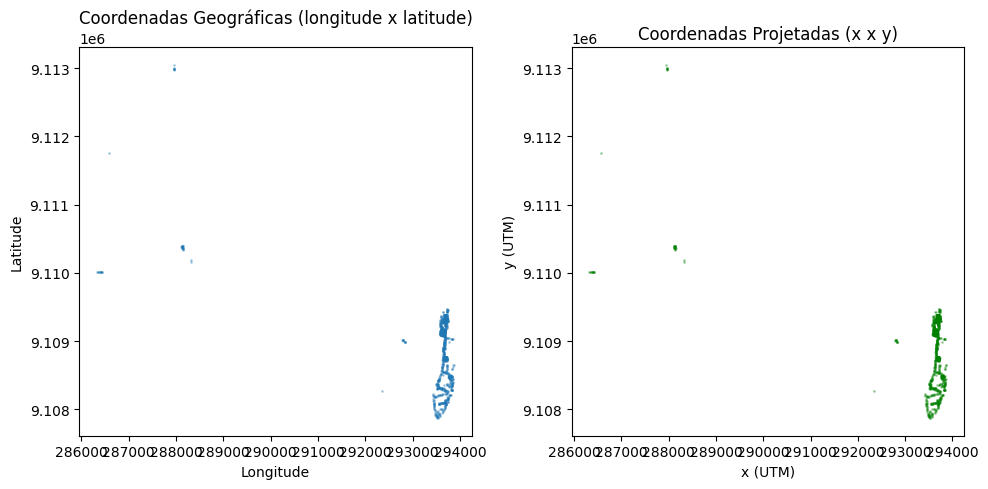

In [61]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10,5))

# Mapa em latitude/longitude
plt.subplot(1,2,1)
plt.scatter(df_mod3["longitude"], df_mod3["latitude"], s=1, alpha=0.3)
plt.title("Coordenadas Geográficas (longitude x latitude)")
plt.xlabel("Longitude")
plt.ylabel("Latitude")

# Mapa em UTM
plt.subplot(1,2,2)
plt.scatter(df_mod3["x"], df_mod3["y"], s=1, alpha=0.3, color="green")
plt.title("Coordenadas Projetadas (x x y)")
plt.xlabel("x (UTM)")
plt.ylabel("y (UTM)")

plt.tight_layout()
plt.show()


In [62]:
print("Faixas de valores esperadas:")
print("Longitude verdadeira: entre -35.05 e -34.80")
print("Latitude verdadeira : entre  -8.10 e  -7.90\n")

print("Faixas atuais do dataset:")
print("longitude:", df_mod3["longitude"].min(), "→", df_mod3["longitude"].max())
print("latitude :", df_mod3["latitude"].min(), "→", df_mod3["latitude"].max())


Faixas de valores esperadas:
Longitude verdadeira: entre -35.05 e -34.80
Latitude verdadeira : entre  -8.10 e  -7.90

Faixas atuais do dataset:
longitude: 286328.2679000003 → 293872.1218999997
latitude : 9107871.9829 → 9113051.915


In [63]:
print("Diferença média entre pares de colunas:")
print("longitude vs x:", (df_mod3["longitude"] - df_mod3["x"]).abs().mean())
print("latitude  vs y:", (df_mod3["latitude"] - df_mod3["y"]).abs().mean())
print("longitude vs x_wgs84:", (df_mod3["longitude"] - df_mod3["x_wgs84"]).abs().mean())
print("latitude  vs y_wgs84:", (df_mod3["latitude"] - df_mod3["y_wgs84"]).abs().mean())

Diferença média entre pares de colunas:
longitude vs x: 0.2951674354762689
latitude  vs y: 0.326898292598775
longitude vs x_wgs84: 293441.3102519054
latitude  vs y_wgs84: 9108878.273372987


In [64]:
# Se precisar:
# !pip install pyproj folium

import pandas as pd
from pyproj import Transformer
import folium
from folium.plugins import FastMarkerCluster

# 1) Filtrar RPAs válidas e coordenadas existentes
df_mapa = df_mod3[df_mod3['rpa'].between(1, 6)].copy()
df_mapa = df_mapa[df_mapa['x'].notna() & df_mapa['y'].notna()]

# 2) Converter de UTM 25S para WGS84 (lon/lat)
# Tente primeiro SIRGAS2000/UTM 25S (EPSG:31985). Se ficar estranho, use WGS84/UTM 25S (EPSG:32725).
transformer = Transformer.from_crs("EPSG:31985", "EPSG:4326", always_xy=True)
# Se necessário, troque para:
# transformer = Transformer.from_crs("EPSG:32725", "EPSG:4326", always_xy=True)

lon, lat = transformer.transform(df_mapa['x'].values, df_mapa['y'].values)
df_mapa['lon'] = lon
df_mapa['lat'] = lat

# Checagem rápida: deve dar ~ (-34.9, -8.0)
df_mapa[['lon','lat']].head()


,lon,lat
4,-34.938620,-8.046906
20,-34.938707,-8.046909
21,-34.937991,-8.046879
26,-34.938249,-8.046890
27,-34.937902,-8.046877


In [65]:
# 3) Mapa interativo em Recife
center = [df_mapa['lat'].mean(), df_mapa['lon'].mean()]
m = folium.Map(location=center, zoom_start=12, tiles="CartoDB positron")

locs = df_mapa[['lat','lon']].values.tolist()
FastMarkerCluster(locs).add_to(m)

m

In [66]:
colunas_nao_numericas = df_mod3.select_dtypes(exclude=['number']).columns
colunas_nao_numericas

Index(['porte_especie', 'bairro', 'nome_popular', 'categoria', 'observacao',
       'tipologia', 'nome_cientifico', 'data_plantio', 'data_monitoramento',
       'injuria', 'fitossanid', 'globalid', 'projeto', 'responsavel',
       'nome_popular_padrao', 'fitossanid_grupo', 'injuria_grupo',
       'injuria_corrigida', 'fitossanid_corrigida', 'bairro_nome'],
      dtype='object')

In [67]:
df_mod3[colunas_nao_numericas].nunique().sort_values(ascending=False)

,0
globalid,894
observacao,147
nome_popular,9
nome_popular_padrao,8
data_plantio,7
bairro_nome,6
bairro,6
fitossanid_corrigida,4
fitossanid,4
tipologia,4


In [68]:
# Seleciona apenas as colunas não numéricas
colunas_nao_numericas = df_mod3.select_dtypes(exclude=['number']).columns

# Remove a coluna 'globalid', se existir
colunas_nao_numericas = [c for c in colunas_nao_numericas if c != 'globalid']

# Mostra os valores únicos de cada coluna, um por linha
for c in colunas_nao_numericas:
    print(f"\n--- {c} ---")
    for valor in df[c].dropna().unique():
        print(valor)



--- porte_especie ---
GP
MP
PP

--- bairro ---
GUA
MAC
SAM
IPU
PAS
PAU
DUN
BGU
BBE
DIR
NOV
CJE
BEB
VCG
PTM
SDP
LTR
CAJ
APP
AJB
AGF
FUN
CDB
AST
MCO
PEI
BBH
AJP
ADM
CAX
ARR
CMG
CSA
VRZ
MGA
MON
POP
HIP
POC
CSF
JAQ
STN
TRR
CRD
CDU
MAD
ZMB
ENG
TES
PRA
CUR
SAT
SMT
IRE
BNG
AFG
COE
SJE
MUS
IJB
MGE
JSP
JIQ
CBG
EST
TOT
SNC
COQ
PIN
ARE
TEJ
BAR
CCT
TMA
RSA
ENC
PAR
GRA
AFT
TAO
ESP
REC
BVS
DBY
SLD
PAI
ILT
BRT
BVG
CHB
JOR
IPS
IMB
IBU

--- nome_popular ---
Ipê-rosa
Ipê-roxo
Ipeamarelo
Pau Brasil
Acácia Mimosa
Espatódea Vermelha
Sombreiro
Coqueiro
Mangueira
Cajazeiro
Pau-Brasil
Cajueiro
Canela
Castanhola
Sabonete
Ipê-branco
Pau-de-jangada
Pau-brasil
Urucum
Sibipiruna
Sapoti-do-mangue
Ipê-amarelo
Jasmin-branco
Algodão-da-praia
Cássia-chuva-de-ouro
Mororó
Nim
Craibeira
Ipê-amarelo (GP)
Pitanga
Pau-formiga
Acássia-cubana
Jasmim-laranja
Aroeira (Pimenta rosa)
Guamirim
Jucá
Palmeira-imperial
Ficus
Espinheiro
Não identificado
Felício
Olho-de-pombo
Acássia-amarela (Seâmea)
Resedá-gigante
Ipê-branco-da-restin

HeatMap - RPA1

In [69]:
# --- 3. Filtrar APENAS RPA 1 ---
df_rpa1 = df[
    (df['rpa'] == 1) &
    df['x'].notna() &
    df['y'].notna()
].copy()

# Criar colunas latitude e longitude (usando as colunas wgs84 que já existem)
df_rpa1['lat'] = df_rpa1['y_wgs84']
df_rpa1['lon'] = df_rpa1['x_wgs84']

# Checar se os valores parecem certos (~ lat -8 e lon -34)
print("Amostra de coordenadas da RPA 1:")
print(df_rpa1[['lat', 'lon']].head())

# --- 4. Criar o Mapa (centralizado na RPA 1) ---
center = [df_rpa1['lat'].mean(), df_rpa1['lon'].mean()]
m_rpa1 = folium.Map(location=center, zoom_start=13, tiles="CartoDB positron")

# Mapa de calor (HeatMap)
HeatMap(
    data=df_rpa1[['lat', 'lon']],
    radius=10,
    blur=15,
    min_opacity=0.4
).add_to(m_rpa1)

# Clusters de pontos (FastMarkerCluster)
FastMarkerCluster(df_rpa1[['lat', 'lon']].values.tolist()).add_to(m_rpa1)

# Exibir o mapa
m_rpa1

Amostra de coordenadas da RPA 1:
         lat        lon
3  -8.042639 -34.884382
5  -8.042803 -34.884222
6  -8.042705 -34.883807
7  -8.042551 -34.884223
18 -8.042758 -34.884261


HeatMap - Bairro do Recife

In [70]:
# --- 3. Filtrar APENAS o Bairro "Recife" ---
# Atenção: Certifique-se de que no seu CSV o nome está escrito exatamente "Recife"
df_bairro = df[
    (df['bairro_nome'] == 'Recife') &
    df['x'].notna() &
    df['y'].notna()
].copy()

# Verificar se encontrou dados (segurança para garantir que o nome do bairro está certo)
print(f"Quantidade de árvores no Bairro do Recife: {len(df_bairro)}")

# Criar colunas latitude e longitude
df_bairro['lat'] = df_bairro['y_wgs84']
df_bairro['lon'] = df_bairro['x_wgs84']

# --- 4. Criar o Mapa (centralizado no Bairro) ---
# Calculamos o centro com base na média das árvores do bairro
center = [df_bairro['lat'].mean(), df_bairro['lon'].mean()]

# Aumentei o zoom_start para 15 ou 16, pois estamos olhando um bairro específico
m_bairro = folium.Map(location=center, zoom_start=16, tiles="CartoDB positron")

# Mapa de calor (HeatMap)
HeatMap(
    data=df_bairro[['lat', 'lon']],
    radius=15,       # Aumentei um pouco o raio para ficar mais visível no nível de bairro
    blur=20,
    min_opacity=0.4
).add_to(m_bairro)

# Clusters de pontos (Opcional: se quiser ver os pontos individuais também)
FastMarkerCluster(df_bairro[['lat', 'lon']].values.tolist()).add_to(m_bairro)

# Exibir o mapa
m_bairro

Quantidade de árvores no Bairro do Recife: 1546


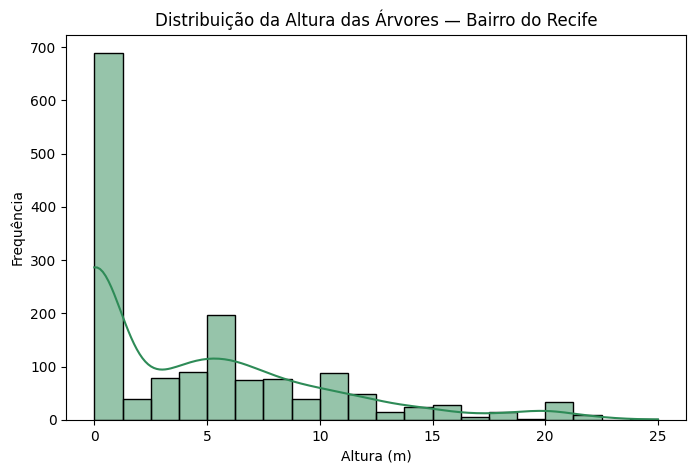

In [71]:
# 1. Filtrar os dados apenas para o bairro "Recife"
df_recife = df[df['bairro_nome'] == 'Recife']

# 2. Gerar o gráfico
plt.figure(figsize=(8,5))

# Usamos df_recife['altura'] agora
sns.histplot(df_recife['altura'], bins=20, color='seagreen', kde=True)

plt.title('Distribuição da Altura das Árvores — Bairro do Recife')
plt.xlabel('Altura (m)')
plt.ylabel('Frequência')
plt.show()

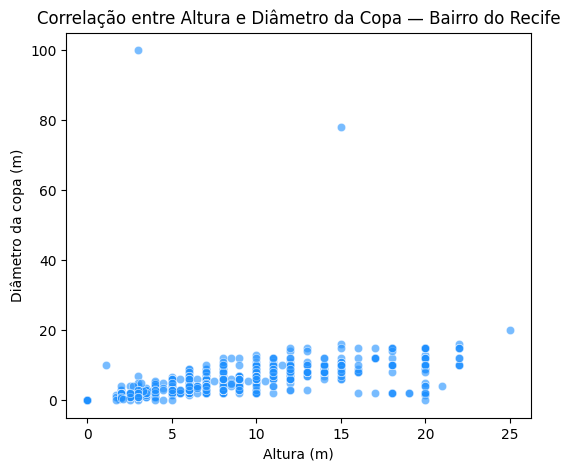

In [72]:
plt.figure(figsize=(6,5))

# 2. Gerar o gráfico usando o dataframe filtrado
sns.scatterplot(x='altura', y='copa', data=df_recife, alpha=0.6, color='dodgerblue')

plt.title('Correlação entre Altura e Diâmetro da Copa — Bairro do Recife')
plt.xlabel('Altura (m)')
plt.ylabel('Diâmetro da copa (m)')
plt.show()

/tmp/ipython-input-2533681115.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_especies.values, y=top_especies.index, palette='Greens_r')


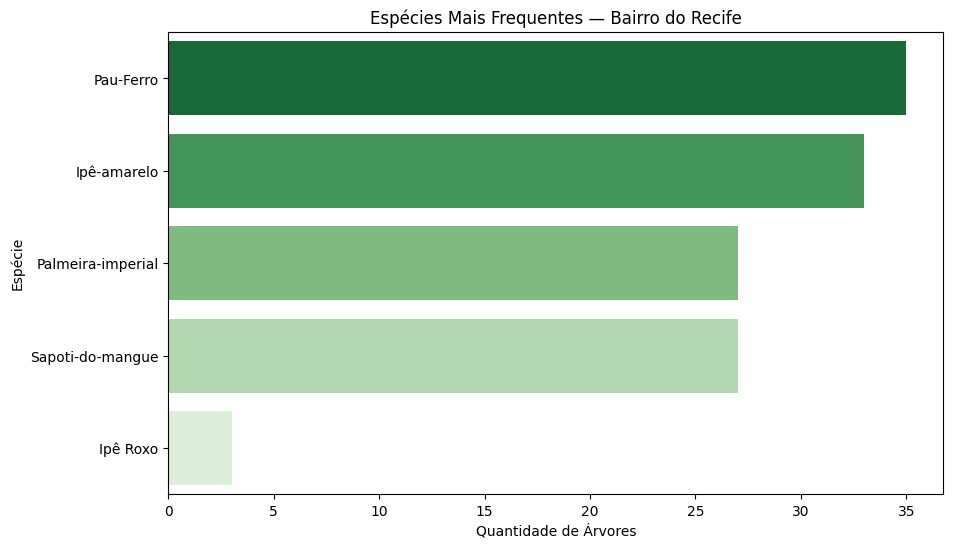

In [73]:
# --- GRÁFICO: Espécies Mais Frequentes ---
top_especies = df_recife['nome_popular'].value_counts().head(10)

plt.figure(figsize=(10, 6)) # Aumentei um pouco a largura para os nomes caberem melhor
sns.barplot(x=top_especies.values, y=top_especies.index, palette='Greens_r')

plt.title('Espécies Mais Frequentes — Bairro do Recife')
plt.xlabel('Quantidade de Árvores')
plt.ylabel('Espécie')
plt.show()

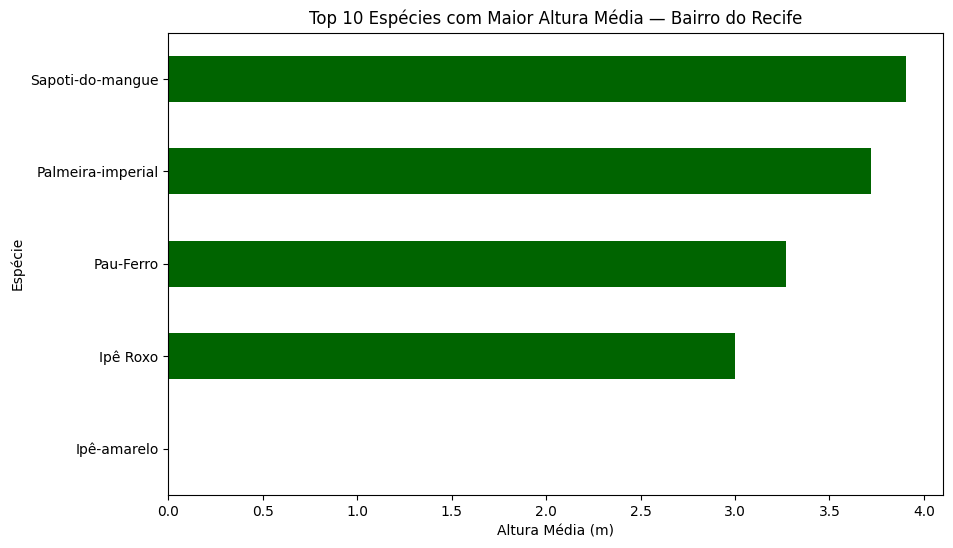

In [74]:
# --- GRÁFICO: Altura Média por Espécie ---
media_altura = df_recife.groupby('nome_popular')['altura'].mean().sort_values(ascending=True).tail(10)

media_altura = df_recife.groupby('nome_popular')['altura'].mean().sort_values(ascending=True).tail(10)

plt.figure(figsize=(10, 6))
media_altura.plot(kind='barh', color='darkgreen')

plt.title('Top 10 Espécies com Maior Altura Média — Bairro do Recife')
plt.xlabel('Altura Média (m)')
plt.ylabel('Espécie')
plt.show()

Análises métricas no Bairro do Recife

=== Correlação de Pearson (Bairro do Recife) ===
        altura  copa   dap   cap
altura    1.00  0.71  0.75  0.75
copa      0.71  1.00  0.71  0.71
dap       0.75  0.71  1.00  1.00
cap       0.75  0.71  1.00  1.00

=== Correlação de Spearman (Bairro do Recife) ===
        altura  copa   dap   cap
altura    1.00  0.74  0.76  0.76
copa      0.74  1.00  0.65  0.65
dap       0.76  0.65  1.00  1.00
cap       0.76  0.65  1.00  1.00

=== P-valores (Pearson) ===
               altura           copa            dap            cap
altura   0.000000e+00  7.201005e-134  2.090310e-154  2.090682e-152
copa    7.201005e-134   0.000000e+00  2.609339e-131  2.609339e-131
dap     2.090310e-154  2.609339e-131   0.000000e+00   0.000000e+00
cap     2.090682e-152  2.609339e-131   0.000000e+00   0.000000e+00


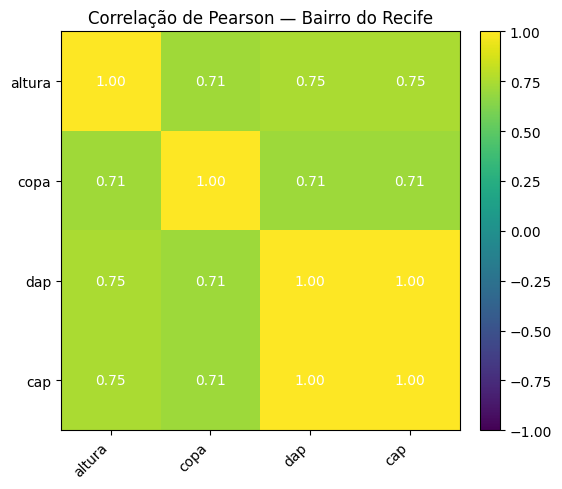

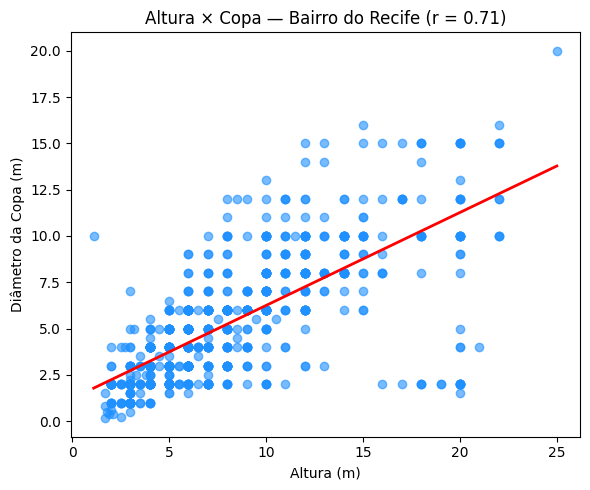


Correlação DAP×CAP (direta): r = 1.00 (n=851)
Erro relativo mediano CAP~π*DAP: 0.00%
Erro relativo mediano DAP~CAP/π: 0.00%


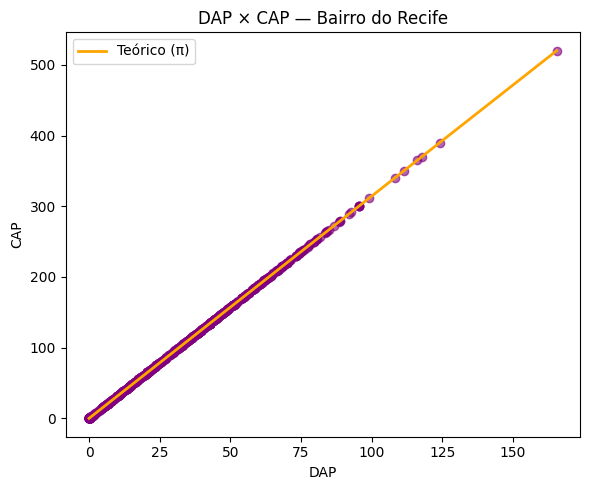

In [75]:
# =========================
# ANÁLISE DE CORRELAÇÕES — BAIRRO DO RECIFE
# =========================
# Requisitos: pandas, numpy, matplotlib; (opcional) scipy para p-valores

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# ---------------------------------------
# 1) CONFIGURAÇÃO DE COLUNAS (aliases)
# ---------------------------------------
# Mantive os aliases das medidas, pois não dependem do local
ALIASES = {
    'altura': ['altura_arvore', 'altura', 'alt', 'altura_m'],
    'copa': ['diametro_copa', 'copa_diametro', 'copa', 'diametro_copa_m'],
    'dap': ['dap', 'diametro_peito', 'diametro_altura_peito'],
    'cap': ['cap', 'circunferencia_peito', 'circ_alt_peito']
}

def first_existing(df, candidates):
    for c in candidates:
        if c in df.columns:
            return c
    return None

COL_ALT    = first_existing(df, ALIASES['altura'])
COL_COPA   = first_existing(df, ALIASES['copa'])
COL_DAP    = first_existing(df, ALIASES['dap'])
COL_CAP    = first_existing(df, ALIASES['cap'])

# ---------------------------------------
# 2) FILTRO BAIRRO DO RECIFE
# ---------------------------------------
# Mudança principal aqui: filtrando pelo nome do bairro
df_recife = df[df['bairro_nome'] == 'Recife'].copy()

if len(df_recife) == 0:
    print("⚠️ AVISO: O dataframe do Bairro do Recife está vazio. Verifique se o nome está escrito exatamente 'Recife'.")

# ---------------------------------------
# 3) SELEÇÃO E LIMPEZA DAS MEDIDAS
# ---------------------------------------
cols = [c for c in [COL_ALT, COL_COPA, COL_DAP, COL_CAP] if c is not None]
if not cols:
    raise ValueError("Não encontrei nenhuma coluna de medidas (altura/copa/dap/cap). Ajuste os aliases.")

# Usamos df_recife agora
data = df_recife[cols].copy()

# Converter para numérico e remover valores absurdos
for c in data.columns:
    data[c] = pd.to_numeric(data[c], errors='coerce')

# Regras simples de sanidade
if COL_ALT in data:
    data.loc[(data[COL_ALT] <= 0) | (data[COL_ALT] > 80), COL_ALT] = np.nan
if COL_COPA in data:
    data.loc[(data[COL_COPA] <= 0) | (data[COL_COPA] > 60), COL_COPA] = np.nan
if COL_DAP in data:
    data.loc[(data[COL_DAP] <= 0) | (data[COL_DAP] > 300), COL_DAP] = np.nan
if COL_CAP in data:
    data.loc[(data[COL_CAP] <= 0) | (data[COL_CAP] > 1000), COL_CAP] = np.nan

# ---------------------------------------
# 4) CORRELAÇÕES (PEARSON) + (opcional) SPEARMAN
# ---------------------------------------
pearson_corr = data.corr(method='pearson', min_periods=20)
spearman_corr = data.corr(method='spearman', min_periods=20)

print("=== Correlação de Pearson (Bairro do Recife) ===")
print(pearson_corr.round(2))
print("\n=== Correlação de Spearman (Bairro do Recife) ===")
print(spearman_corr.round(2))

# (Opcional) p-valores via scipy
try:
    from scipy.stats import pearsonr
    pvals = pd.DataFrame(np.ones((len(cols), len(cols))), index=cols, columns=cols)
    for i, ci in enumerate(cols):
        for j, cj in enumerate(cols):
            x = data[ci]
            y = data[cj]
            mask = x.notna() & y.notna()
            if mask.sum() >= 20 and i != j:
                r, p = pearsonr(x[mask], y[mask])
                pvals.loc[ci, cj] = p
            elif i == j:
                pvals.loc[ci, cj] = 0.0
            else:
                pvals.loc[ci, cj] = np.nan
    print("\n=== P-valores (Pearson) ===")
    print(pvals)
except Exception as e:
    print("\n(Obs.: scipy não disponível para p-valores; seguindo sem p-valor)")

# ---------------------------------------
# 5) MATRIZ DE CORRELAÇÃO (HEATMAP)
# ---------------------------------------
fig = plt.figure(figsize=(6,5))
im = plt.imshow(pearson_corr, vmin=-1, vmax=1) # cmap='coolwarm' é uma boa opção também
plt.title('Correlação de Pearson — Bairro do Recife')
plt.xticks(ticks=np.arange(len(cols)), labels=cols, rotation=45, ha='right')
plt.yticks(ticks=np.arange(len(cols)), labels=cols)

# Anotações numéricas nas células
for i in range(len(cols)):
    for j in range(len(cols)):
        val = pearson_corr.iloc[i, j]
        if pd.notna(val):
            plt.text(j, i, f"{val:.2f}", ha='center', va='center',
                     color='black' if abs(val) < 0.5 else 'white') # Pequeno ajuste de cor para leitura

plt.colorbar(im, fraction=0.046, pad=0.04)
plt.tight_layout()
plt.show()

# ---------------------------------------
# 6) DISPERSÃO ALTURA × COPA COM REGRESSÃO
# ---------------------------------------
if (COL_ALT in data) and (COL_COPA in data):
    xy = data[[COL_ALT, COL_COPA]].dropna()
    if len(xy) >= 20:
        x = xy[COL_ALT].values
        y = xy[COL_COPA].values

        # Regressão linear simples
        m, b = np.polyfit(x, y, 1)  # y = m*x + b
        r = np.corrcoef(x, y)[0,1]

        fig = plt.figure(figsize=(6,5))
        plt.scatter(x, y, alpha=0.6, color='dodgerblue') # Cor ajustada
        xline = np.linspace(x.min(), x.max(), 100)
        yline = m*xline + b
        plt.plot(xline, yline, linewidth=2, color='red')
        plt.xlabel('Altura (m)')
        plt.ylabel('Diâmetro da Copa (m)')
        plt.title(f'Altura × Copa — Bairro do Recife (r = {r:.2f})')
        plt.tight_layout()
        plt.show()
    else:
        print("Amostra insuficiente para Altura×Copa (precisa de >=20 pares não-nulos).")

# ---------------------------------------
# 7) CONSISTÊNCIA DAP × CAP
# ---------------------------------------
if (COL_DAP in data) and (COL_CAP in data):
    dc = data[[COL_DAP, COL_CAP]].dropna()
    if len(dc) >= 20:
        # Comparação direta:
        corr_dc = dc.corr(method='pearson').iloc[0,1]
        print(f"\nCorrelação DAP×CAP (direta): r = {corr_dc:.2f} (n={len(dc)})")

        # Conversões teóricas:
        cap_from_dap = np.pi * dc[COL_DAP]
        dap_from_cap = dc[COL_CAP] / np.pi

        # Erro relativo mediano:
        erm1 = ( (cap_from_dap - dc[COL_CAP]).abs() / dc[COL_CAP] ).median()
        erm2 = ( (dap_from_cap - dc[COL_DAP]).abs() / dc[COL_DAP] ).median()
        print(f"Erro relativo mediano CAP~π*DAP: {erm1:.2%}")
        print(f"Erro relativo mediano DAP~CAP/π: {erm2:.2%}")

        # Dispersão DAP×CAP
        fig = plt.figure(figsize=(6,5))
        plt.scatter(dc[COL_DAP], dc[COL_CAP], alpha=0.6, color='purple')
        # Linha teórica CAP = π*DAP
        xline = np.linspace(dc[COL_DAP].min(), dc[COL_DAP].max(), 100)
        plt.plot(xline, np.pi*xline, linewidth=2, color='orange', label='Teórico (π)')
        plt.xlabel('DAP')
        plt.ylabel('CAP')
        plt.title('DAP × CAP — Bairro do Recife')
        plt.legend()
        plt.tight_layout()
        plt.show()
    else:
        print("Amostra insuficiente para DAP×CAP (precisa de >=20 pares não-nulos).")
else:
    print("\nDAP ou CAP ausentes — pulei a checagem de consistência DAP×CAP.")

Correlação sem CAP

=== Correlação de Pearson (Bairro do Recife) ===
        altura  copa   dap
altura    1.00  0.48  0.75
copa      0.48  1.00  0.48
dap       0.75  0.48  1.00

=== Correlação de Spearman (Bairro do Recife) ===
        altura  copa   dap
altura    1.00  0.73  0.76
copa      0.73  1.00  0.65
dap       0.76  0.65  1.00


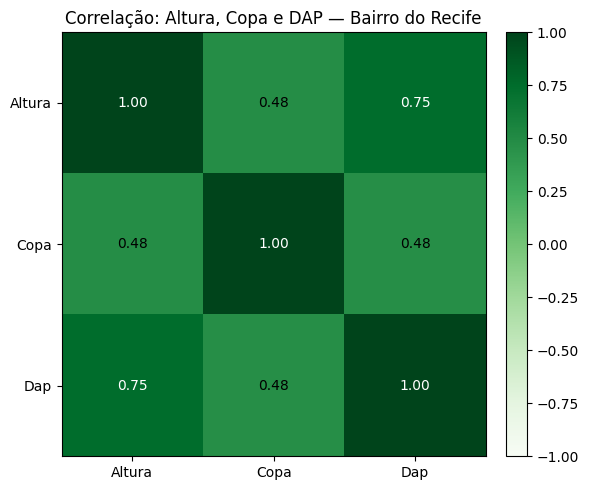

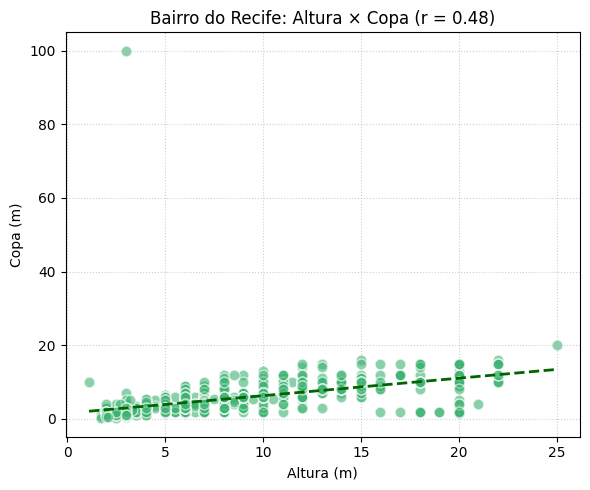

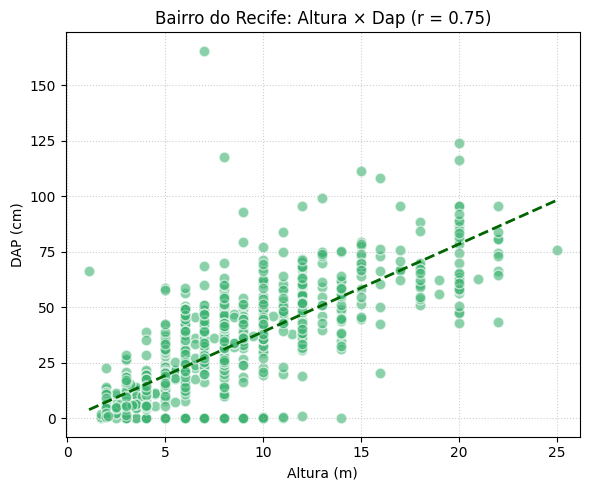

In [76]:
# ==========================================================
# ANÁLISE DE CORRELAÇÃO ENTRE ALTURA, COPA E DAP — BAIRRO DO RECIFE
# ==========================================================

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns # Importando seaborn para melhorar visual do heatmap se disponível

# ------------------------------------------
# 1) Filtrar apenas Bairro do Recife
# ------------------------------------------
# Certifique-se que seu dataframe principal se chama 'df'
#df_recife = df[df['bairro_nome'] == 'Recife'].copy()

# Validação rápida
#if len(df_recife) == 0:
    #print("⚠️ Aviso: Nenhum dado encontrado. Verifique se o nome do bairro no CSV é exatamente 'Recife'.")

# ------------------------------------------
# 2) Selecionar as variáveis de interesse
# ------------------------------------------
cols = ['altura', 'copa', 'dap']
data = df_recife[cols].copy()

# Converter para valores numéricos e limpar outliers
for c in cols:
    data[c] = pd.to_numeric(data[c], errors='coerce')
    # Remove zeros, negativos e NaNs
    data.loc[data[c] <= 0, c] = np.nan

# Remove linhas que tenham ficado com NaN após a limpeza
data = data.dropna()

# ------------------------------------------
# 3) Calcular correlações (Pearson e Spearman)
# ------------------------------------------
corr_pearson = data.corr(method='pearson')
corr_spearman = data.corr(method='spearman')

print("=== Correlação de Pearson (Bairro do Recife) ===")
print(corr_pearson.round(2))
print("\n=== Correlação de Spearman (Bairro do Recife) ===")
print(corr_spearman.round(2))

# ------------------------------------------
# 4) Matriz de correlação (heatmap simples)
# ------------------------------------------
fig = plt.figure(figsize=(6, 5))
im = plt.imshow(corr_pearson, vmin=-1, vmax=1, cmap='Greens')
plt.title('Correlação: Altura, Copa e DAP — Bairro do Recife')
plt.xticks(range(len(cols)), [c.title() for c in cols], rotation=0) # Rotação 0 fica melhor com poucos itens
plt.yticks(range(len(cols)), [c.title() for c in cols])

# Inserir valores no heatmap
for i in range(len(cols)):
    for j in range(len(cols)):
        val = corr_pearson.iloc[i, j]
        # Muda a cor do texto para branco se o fundo for muito escuro (valor alto)
        text_color = 'white' if val > 0.6 else 'black'
        plt.text(j, i, f"{val:.2f}", ha='center', va='center', color=text_color)

plt.colorbar(im, fraction=0.046, pad=0.04)
plt.tight_layout()
plt.show()

# ------------------------------------------
# 5) Dispersão: Altura × Copa e Altura × DAP
# ------------------------------------------
pairs = [('altura', 'copa'), ('altura', 'dap')]

for x_col, y_col in pairs:
    df_xy = data[[x_col, y_col]].dropna()

    if len(df_xy) > 20:
        x = df_xy[x_col]
        y = df_xy[y_col]

        # Cálculos estatísticos
        r = np.corrcoef(x, y)[0, 1]
        m, b = np.polyfit(x, y, 1) # Coeficientes da reta (y = mx + b)

        plt.figure(figsize=(6, 5))

        # Scatter plot
        plt.scatter(x, y, alpha=0.6, color='mediumseagreen', edgecolors='w', s=60)

        # Linha de tendência
        plt.plot(np.linspace(x.min(), x.max(), 100),
                 m * np.linspace(x.min(), x.max(), 100) + b,
                 color='darkgreen', linewidth=2, linestyle='--')

        plt.xlabel(x_col.title() + ' (m)' if x_col != 'dap' else x_col.upper() + ' (cm)')
        plt.ylabel(y_col.title() + ' (m)' if y_col != 'dap' else y_col.upper() + ' (cm)')

        plt.title(f'Bairro do Recife: {x_col.title()} × {y_col.title()} (r = {r:.2f})')
        plt.grid(True, linestyle=':', alpha=0.6)
        plt.tight_layout()
        plt.show()
    else:
        print(f"Dados insuficientes para plotar {x_col} vs {y_col} no Bairro do Recife.")